# Coursework 1: Learning Learning, From Scratch

_COMP0169 Team_

__Niloy J. Mitra & Tobias Ritschel__

TAs:  __Remy Sabathier, Niladri Shekhar Dutt & Binglun Wang__

The total points for this exercise is 100.

Please refer to Moodle submission page for the due date.


## Submission instructions:

Coursework submissions must comprise of a zipped folder. Inside this zip, you should have two things.


1.   This Jupyter notebook, containing your code and written comments.
2.   A "models/" folder, containing your trained model weights.


 In the notebook, cells that need to be changed are clearly stated with a &#9998; symbol and you are not allowed to change the rest of the code in any way. Descriptive answers must be contained in the markdown blocks starting with "_Your reply_:". Code must only be written in the space inside the `#begin_solution ... #end_solution` blocks. Code written outside these blocks will not be processed or evaluated.

Please, do not change `#begin_test ... #end_test` blocks, these blocks are for TAs.

Each exercise must be implemented from scratch. Unless differently specified, only numpy and matplotlib are allowed. The libraries are imported in [the package cell](#packages) and cannot be modified.



**Questions:**

[Question 1](#question1): Linear Fitting (10 points)

[Question 2](#question2): Image retrieval (15 points)

[Question 3](#question3): Image Denoising (30 points)

[Question 4](#question4): Texture Synthesis (15 points)

[Question 5](#question5): Neural Implicit Representation (30 points)

## Datasets

We will be using several datasets for the coursework: _IRIS_ , _MNIST_ , _CelebA_ , _NoisyOCR_.

_IRIS_ and _MNIST_ datasets will be downloaded directly in the notebook using the `skdataset` library. Keep in mind that you will need to be connected to Internet to be able to download the datasets. If you want to work offline, you are free to save your dataset to npy file locally and load them while offline although this is not officially supported.

_CelebA_ and _NoisyOCR_ are provided separately in a zip file; make sure to unzip it and the unzipped folder is placed in the same directory as the notebook.


**_IRIS_**: The _IRIS_ dataset contains the following features in order: _sepal length_, _sepal width_, _petal length_, _petal width_. Classes names are: __Iris Setosa__ for label **0**, __Iris Versicolour__ for label **1**, and __Iris Virginica__ for label **2**.

**_MNIST_**: _MNIST_ is a dataset composed of images of handwritten digits.

**_NoisyOCR_**: _NoisyOCR_ is a dataset composed of
images of noisy OCR scans, along with corresponding clean target images.

The script will generate two subsets for each of the two datasets, a training subset (**X\_dataset** and **Y\_dataset** with **dataset** the name of the dataset) and a test subset (**X\_dataset\_test** and **Y\_dataset\_test**).

We will test correctness of your code on _Hidden_ set.

**Warning:** as _Hidden_ may have different dimensions from _IRIS_ and _MNIST_, hard-coded solutions may not work, thus resulting in lower grades. You need to make sure that your code would work if applied on a different number of samples and a different number of features/pixels.

## Instructions for the other datasets zip file:
**Download Link:** https://geometry.cs.ucl.ac.uk/mlvc/cw_datasets.zip

You can download this zip locally, unzip it and keep the folder in the same directory as your Notebook. There is code provided below to download and unzip it. If you're using Colab, the downloaded content will remain only while the session is active. When you start a new session, you'd have to download it again.

**Google Drive:** For a more permanent solution, you can upload the *unzipped* folder to your own Google Drive, and mount your drive in the notebook. Code is provided below, to mount the drive.

You can use either options, and a variable `drive_mount` is provided to toggle between the two. Set this variable accordingly.

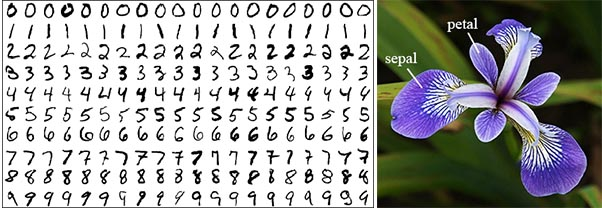

The following cell imports all packages needed in the coursework. You are not allowed to use any other packages than the ones listed below.
<a name='packages'></a>

In [1]:
# Importing packages
import numpy as np
import random
import os

import matplotlib.pyplot as plt

from scipy import optimize
from sklearn import datasets as skdataset
from sklearn.model_selection import train_test_split
from pathlib import Path

import os
from PIL import Image

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset

import imageio
from PIL import Image
import cv2

from tqdm import tqdm
from skimage.metrics import peak_signal_noise_ratio
from IPython.display import Video

from torchvision import models, transforms
%matplotlib inline

The following code imports the drive module from Colab. This code will only run on Colab. If you're not using Colab, comment this code out, or don't run this cell.

In [2]:
from google.colab import drive

#Unmount any previously mounted drive if needed.
#Feel free to uncomment below line when you need to unmount Drive

drive.flush_and_unmount()

Drive not mounted, so nothing to flush and unmount.


The following cell sets the `drive_mount` variable. Set it to `True` if your Dataset folder is on drive. If you plan to use the Dataset folder locally, then set this to `False`

In [3]:
drive_mount = False

In [4]:
# Setting the seed
RAND_ST = 42
random.seed(RAND_ST)
#begin_test


#end_test




## Data Loading

The following cells are used to load IRIS and MNIST datasets.

In [5]:
def load_iris_dataset(num_classes=2):
    # Load the datadet from SkDataset
    iris = skdataset.load_iris()
    X = iris.data
    Y = iris.target
    # Reduce the number of classes
    idx = Y < num_classes
    X = X[idx]
    Y = Y[idx]
    return X, Y

In [6]:
def load_mnist_dataset(num_classes=2):
    # Load the datadet from SkDataset
    X, Y = skdataset.fetch_openml('mnist_784', version=1, return_X_y=True,as_frame=False)
    Y = Y.astype(np.int64)
    # Reduce the number of classes
    idx = Y < num_classes
    X = X[idx]
    Y = Y[idx]
    return X, Y

def load_mnist_dataset_onevsall(class_id=7):
    # Load the datadet from SkDataset
    X, Y = skdataset.fetch_openml('mnist_784', version=1, return_X_y=True,as_frame=False)
    Y = Y.astype(np.int64)
    # One versus all
    idx = Y == class_id
    Y[~idx] = 0
    Y[idx]  = 1
    return X, Y

## Functions for visualization

In [7]:
def plot_correlation(X1, X2):
    # Plot both variables
    plt.figure(figsize=(8, 6))
    plt.clf()
    plt.scatter(X1, X2, edgecolor='k')
    line = np.linspace(min(X1.min(), X2.min()), max(X1.max(), X2.max()), 20)
    plt.plot(line, line, 'r')
    plt.xlabel('Variable 1')
    plt.ylabel('Variable 2')
    plt.show()

In [8]:
def plot_eigenvecs(stacked_images, n_rows, n_columns, img_shape=None, channels=1):
    n_images, n_dims = stacked_images.shape
    plt.figure()
    for i in range(n_rows * n_columns):
        plt.subplot(n_rows, n_columns, i + 1)
        if channels == 1:
            # Normalize eigen vector to [0, 255] range
            eigenvector = stacked_images[i] - np.min(stacked_images[i])
            eigenvector /= np.max(eigenvector) + 1e-8
            eigenvector = (eigenvector * 255).astype(np.uint8)
            plt.imshow(np.reshape(eigenvector, [int(np.sqrt(n_dims)), int(np.sqrt(n_dims))]), cmap='gray')
        elif channels == 3:
            # Normalize eigen vector to [0, 255] range for each channel
            eigenvector = stacked_images[i].reshape(img_shape[0], img_shape[1], 3)
            eigenvector -= np.min(eigenvector)
            eigenvector /= np.max(eigenvector) + 1e-8
            eigenvector = (eigenvector * 255).astype(np.uint8)
            plt.imshow(eigenvector)
        plt.axis('off')
    plt.show()

def plot_images(stacked_images, n_rows, n_columns, titles, num_channels=1):
    n_images, n_dims = stacked_images.shape
    plt.figure()
    for i in range(n_rows * n_columns):
        plt.subplot(n_rows, n_columns, i + 1)

        if num_channels == 1:
            # Grayscale image
            plt.imshow(np.reshape(stacked_images[i], [int(np.sqrt(n_dims)), int(np.sqrt(n_dims))]), cmap='gray', vmin=0, vmax=1)
        elif num_channels == 3:
            # RGB image
            image = np.reshape(stacked_images[i], [int(np.sqrt(n_dims // 3)), int(np.sqrt(n_dims // 3)), 3])
            image = np.clip(image, 0, 1)  # Ensure pixel values are within [0, 1] range
            plt.imshow(image)
        else:
            raise ValueError("Unsupported number of channels. Use num_channels=1 for grayscale or num_channels=3 for RGB.")

        plt.axis('off')

        if len(titles) == n_rows * n_columns:
            plt.title(titles[i])

    plt.show()

def plot_images_with_text(images, titles, texts=None):
    N_cols = len(images)
    N_rows = len(images[0])

    fig, axs = plt.subplots(N_rows, N_cols, figsize=(20, 15))

    if titles is not None:
        for i, ax in enumerate(axs[0]):
            ax.set_title(titles[i])

    for i, img_col in enumerate(images):
        for j, img in enumerate(img_col):
            if len(img.shape) == 2:
                axs[j,i].imshow(img, interpolation='nearest', cmap='gray')
            else:
                axs[j,i].imshow(img, interpolation='nearest')
            axs[j,i].axis('off')
            if texts is not None:
                axs[j,i].text(0.5,-0.1, str(texts[j][i])[:4], size=10, ha="center", transform=axs[j,i].transAxes)
    plt.show()



In [9]:
def plot_images_horizontal(imgs):
    num_imgs = len(imgs)
    f = plt.figure(figsize=(40, 15))
    for i in range(num_imgs):
        f.add_subplot(1, num_imgs, i+1)
        plt.imshow(imgs[i])
    plt.show()

In [10]:
def true_positive(Y_test, y_pred):
    mask = (Y_test == 1)
    tp = (Y_test[mask] == y_pred[mask]).sum()
    return tp.item()

def true_negative(Y_test, y_pred):
    mask = (Y_test == 0) | (Y_test == -1)
    tn = (Y_test[mask] == y_pred[mask]).sum()
    return tn.item()

def false_negative(Y_test, y_pred):
    mask = (y_pred == 0) | (y_pred == -1)
    tn = (Y_test[mask] != y_pred[mask]).sum()
    return tn.item()

def false_positive(Y_test, y_pred):
    mask = (y_pred == 1)
    tn = (Y_test[mask] != y_pred[mask]).sum()
    return tn.item()

def plot_confusion_matrix(Y_test, y_pred):
    tp = true_positive(Y_test, y_pred)
    tn = true_negative(Y_test, y_pred)
    fp = false_positive(Y_test, y_pred)
    fn = false_negative(Y_test, y_pred)
    cf = np.array([[tn, fp], [fn, tp]])
    fig, ax = plt.subplots()
    ax.matshow(cf, cmap=plt.cm.Blues)
    for i in range(2):
        for j in range(2):
            c = cf[i,j]
            ax.text(j, i, str(c), va='center', ha='center')
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.show()

## Data Loading

In the following cells, the dataset is created with proper splits between training and test set.

_IRIS_ dataset

In [11]:
X, Y = load_iris_dataset(num_classes=3)
X_iris, X_iris_test, Y_iris, Y_iris_test = train_test_split(X, Y, test_size=0.1, random_state=RAND_ST) # 90% training and 10% test

_MNIST_ **dataset**

In [12]:
X, Y = load_mnist_dataset(num_classes=10)
X = X / 255.0
X_mnist, X_mnist_test, Y_mnist, Y_mnist_test = train_test_split(X, Y, test_size=0.1, random_state=RAND_ST) # 90% training and 10% test

**Code for handling the Dataset zip file**

The following cell mounts your drive if `drive_mount` is `True`

In [13]:
if drive_mount:
  drive.mount('/content/drive')

Set `dataset_path` to Drive or local directory.

In [14]:
if drive_mount:
  dataset_path = '/content/drive/MyDrive/cw_datasets/'
  assert(os.path.exists(dataset_path))
  # Set this path to your appropriate drive path
else:
  dataset_path = "./cw_datasets"
  # In this case, the datasets path is assumed to be in the same directory as this notebook

if not os.path.exists("./cw_datasets"):
  !wget https://geometry.cs.ucl.ac.uk/mlvc/cw_datasets.zip
  !unzip -q -o cw_datasets.zip

## 1. Linear Fitting (10 points)
<a name='question1'></a>

[a)](#question1a) Implement the normal equation solver function **nsolve**, which takes as input the matrix **X** and the target vector **y** and returns the optimized weights **w**. Test your code with your own mockup/randomly created data. (**5 points**)

[b)](#question1b) Implement **line_fit(X,y)** which should fit a linear function to the input data. Test your implementation on the following task: predict with linear fitting the _petal length (cm)_ of the Iris dataset using the three remaining variables as inputs (_sepal length (cm)_, _sepal width (cm)_ and _petal width (cm)_). Report the L2 loss on the validation set and plot a graph showing the correlation between y and your prediction on the test set. (**2 points**)

[c)](#question1c) Implement **poly_fit(X,y)** which should fit a 2nd degree polynomial to the input data. Test your implementation on the following task: predict with the polynomial the petal width (cm) of the _IRIS_ dataset using the three remaining variables as inputs (sepal length (cm), sepal width (cm), petal length (cm)). The 2nd degree polynomial should consider all possible pairwise terms, i.e. $w_1x^2 + w_2xy+ w_3y^2 + w_4x+ w_5y+ w_6$ in the case of two input variables $x$ and $y$. Report the L2 loss on the validation set and plot a graph showing the correlation between $y$ and your prediction on the test set. (**3 points**)

**Question 1a**
<a name='question1a'></a>

Implement the nsolve function

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [56]:
def nsolve(X,y):
    """
    Write your implementation of nsolve here.

    Arguments:
    X : Data matrix
    y : Labels

    Returns:
    w : Weights
    """

    #begin_solution
    #bias trick
    X = np.column_stack([np.ones([len(X),1]),X])

    w = np.matmul(np.matmul(np.linalg.inv(np.matmul(X.T, X)), X.T), y)
    #end_solution


    return w

Testing your code on mockup/randomly created data.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [57]:
"""
After implementing nsolve, test it below on some mock data using np.random
"""

#begin_solution
X = np.random.rand(100, 3)
X_bias = np.column_stack([np.ones([len(X),1]),X])

true_weights = np.random.rand(4)

y = np.matmul(X_bias, true_weights)

weights = nsolve(X, y)
print("True weights:", true_weights)
print("Optimized weights:", weights)
#end_solution



True weights: [0.74505817 0.83127615 0.80619344 0.42570046]
Optimized weights: [0.74505817 0.83127615 0.80619344 0.42570046]


**Question 1b**
<a name='question1b'></a>

Implement the line_fit function and test

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [58]:
def line_fit(X,y):
    """
    Write your implementation of line_fit here.

    Arguments:
    X : Data matrix
    y : Labels

    Returns:
    w : Weights
    l2_error : L2 Prediction error using learned w
    """

    #begin_solution
    w = nsolve(X, y)

    X_bias = np.column_stack([np.ones([len(X),1]),X])
    y_pred = np.matmul(X_bias, w)

    l2_error = np.mean((y - y_pred) ** 2)

    #end_solution


    return w, l2_error

Testing your code on _IRIS_

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [59]:
"""
After implementing line_fit, test it below on IRIS Train set.
Print the L2 error on the Training set.
"""

#begin_solution

X = np.delete(X_iris.copy(), 2, axis=1)

y = X_iris[:, 2]

w_train, l2_error_train = line_fit(X, y)
print("L2 error on training set:", l2_error_train)

#end_solution


L2 error on training set: 0.09254280323050398


&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [60]:
"""
After implementing line_fit, test it below on IRIS Test set.
Print the L2 error with respect to Test set.
"""

#begin_solution
X = np.delete(X_iris_test.copy(), 2, axis=1)

y = X_iris_test[:, 2]

w_test, l2_error_test = line_fit(X, y)
print("L2 error on training set:", l2_error_test)
#end_solution


L2 error on training set: 0.10892540899202931


Showing the correlation between X and y.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

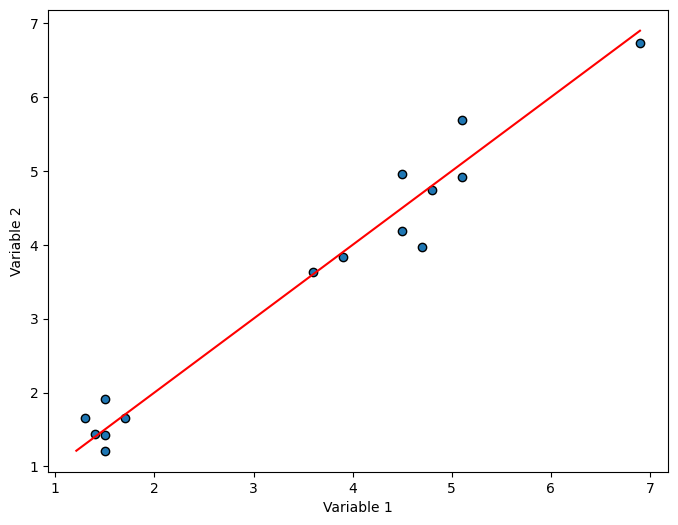

In [61]:
"""
Below, plot and display the correlation between true y and predicted values.
"""
#begin_solution
X = np.delete(X_iris_test.copy(), 2, axis=1)
X_bias = np.column_stack([np.ones([len(X),1]),X])

y_true = X_iris_test[:, 2]
y_pred = np.matmul(X_bias, w_test)

plot_correlation(y_true, y_pred)

#end_solution


Do not write anything in the cell below, it is for TAs

In [ ]:
#begin_test


#end_test



**Question 1c**
<a name='question1c'></a>

Implement the poly_fit function and test

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [62]:
def poly_fit(X,y):
    """
    Write your implementation of poly_fit here.

    Arguments:
    X : Data matrix
    y : Labels

    Returns:
    w : Weights
    l2_error : L2 prediction error using learned w
    """

    #begin_solution
    features = [X]
    for i in range(X.shape[1]):
      for j in range(i, X.shape[1]):
        if i != j:
          features.append(X[:, i] * X[:, j])
    features.append(X ** 2)

    X_poly = np.column_stack(features)

    w = nsolve(X_poly, y)

    X_bias = np.column_stack([np.ones([len(X_poly),1]),X_poly])
    y_pred = np.matmul(X_bias, w)

    l2_error = np.mean((y - y_pred) ** 2)

    #end_solution


    return w, l2_error

Testing your code on _IRIS_.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [63]:
"""
After implementing poly_fit, test it below on IRIS Training set.
Print L2 error with respect to training set.
"""

#begin_solution
X = np.delete(X_iris.copy(), 3, axis=1)

y = X_iris[:, 3]

w_train, l2_error_train = poly_fit(X, y)
print("L2 error on training set:", l2_error_train)

#end_solution


L2 error on training set: 0.03097907441410423


&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [65]:
"""
After implementing poly_fit, test it below on IRIS Test set.
Print L2 error with respect to test set.
"""

#begin_solution
X = np.delete(X_iris_test.copy(), 3, axis=1)

y = X_iris_test[:, 3]

w_test, l2_error_test = poly_fit(X, y)
print("L2 error on training set:", l2_error_test)
#end_solution


L2 error on training set: 0.024416815978255253


Showing the correlation between X and y.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

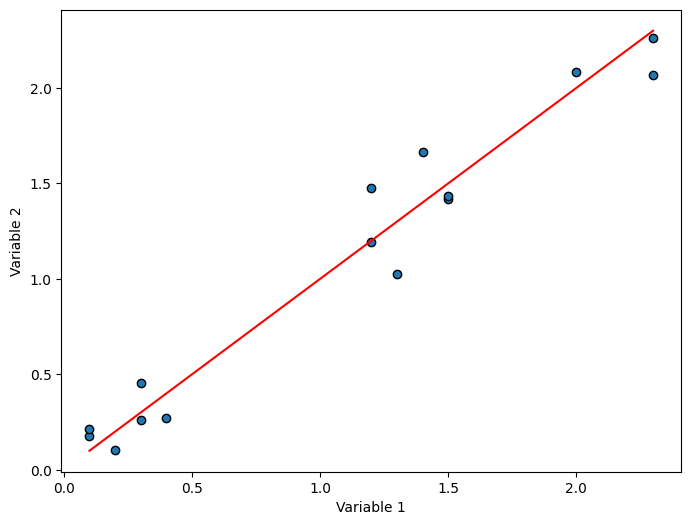

In [66]:
"""
Below, plot and display the correlation between true y and predicted values
"""

#begin_solution
X = np.delete(X_iris_test.copy(), 3, axis=1)

features = [X]
for i in range(X.shape[1]):
  for j in range(i, X.shape[1]):
    if i != j:
      features.append(X[:, i] * X[:, j])
features.append(X ** 2)
X_poly = np.column_stack(features)
X_bias = np.column_stack([np.ones([len(X_poly),1]),X_poly])

y_pred = np.matmul(X_bias, w_test)

y_true = X_iris_test[:, 3]

plot_correlation(y_true, y_pred)

#end_solution


Do not write anything the cell below, it is for TAs

In [ ]:
#begin_test


#end_test



## 2. Image retrieval (15 points)
<a name='question2'></a>

Image retrieval means there is a query, and there is a database. Your job is to find the most similar image from the database. What is considered similar depends on the features used.

[a)](#question2a) Implement four different feature spaces: rgb distance, histogram distance, vgg features and vgg features gram matrix. You can only use the torchvision and torch library (**4 points** + **1 points** for your vectorised version (return features by a batch_size instead of for loop))

[b)](#question2b) Implement an algorithm to retrieve the index of the most similar image from the database. we will use a hidden query and hidden DB to test this. make sure your code works with all DB sizes and resolutions. For testing, you are given a single database with N entries and M querys.
(**4 points** + **1 points** for your vectorised version (return features by a batch_size instead of for loop))

The hidden dataset images size are from (64, 64, 3) to (256, 256, 3).

[c)](#question2c) Discuss and document, why each of the M-times-N results is what it is.
(**5 points**)

**Question 2a**



&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [67]:
!pip install gdown
import gdown
from PIL import Image
import numpy as np
from matplotlib import pyplot as plt

# Download the zip file from Google Drive
output = 'dataset.zip'
gdown.download(id='1udnykJuPVa219EB4X0zSaW9Umi-pGvVm', output=output, quiet=False)


# Unzip the file to the specified folder
!unzip -qq dataset.zip -d ./dataset

Downloading...
From: https://drive.google.com/uc?id=1udnykJuPVa219EB4X0zSaW9Umi-pGvVm
To: /content/dataset.zip
100%|██████████| 57.0k/57.0k [00:00<00:00, 40.1MB/s]


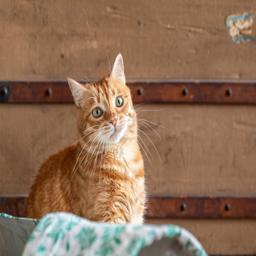

In [68]:
if drive_mount:
  query_img = Image.open('/content/dataset/Image_Retrieval_student_data/query.JPEG')
else:
  query_img = Image.open('./dataset/Image_Retrieval_student_data/query.JPEG')
query_img

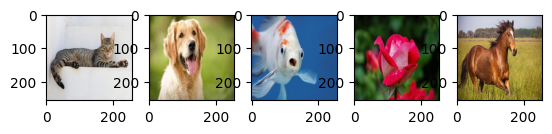

In [69]:
database_imgs_list = []
for i in range(5):
    if drive_mount:
        tmp_img = Image.open(f'/content/dataset/Image_Retrieval_student_data/{i + 1}.JPEG')
    else:
        tmp_img = Image.open(f'./dataset/Image_Retrieval_student_data/{i + 1}.JPEG')
    database_imgs_list.append(tmp_img)

plt.figure()
for i in range(5):
    plt.subplot(1, 5, i + 1)
    plt.imshow(database_imgs_list[i])
plt.show()

In [70]:
vgg = None
# Load the pretrained vgg19 model, we recommend you to use torchvision.models. And you can search to find a pretrained vgg19 model

#begin_solution
vgg = models.vgg19(pretrained=True).features.eval()

preprocess = transforms.Compose([transforms.Resize((224, 224)),transforms.ToTensor(),])

vgg = nn.Sequential(*list(vgg)[:36])

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
vgg = vgg.to(device)

#end_solution


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 144MB/s]


In [71]:
def get_features(img, mod):
    """
    Get the features of the image

    Arguments:
    img : an image, PIL image; or a list of images, [PIL image, PIL image, ...]
    mod : the model to use to extract features
    mod == 1: return the image
    mod == 2: return the histogram
    mod == 3: return the vgg19 feature
    mod == 4: return the vgg19 feature gram matrix

    Returns:
    features : Features of the image as a numpy array; or a list of features numpy array, [features, features, ...]
    """
    features = None
    #begin_solution

    def gram_matrix(features):
      N, C, H, W = features.size()
      features = features.view(N, C, -1)
      gram = torch.bmm(features, features.transpose(1, 2))
      return gram

    if not isinstance(img, list):
      img = [img]

    if mod == 1:
      features = np.array([np.array(i).astype(np.float32).flatten() for i in img])
    elif mod == 2:
      img_array = np.array([np.array(i).flatten() for i in img])
      features = np.apply_along_axis(lambda x: np.histogram(x, bins=256, range=(0, 256))[0], axis=1, arr=img_array)
    elif mod == 3 or mod ==4:
      mean = [0.485, 0.456, 0.406]
      std = [0.229, 0.224, 0.225]
      preprocess = transforms.Compose([transforms.Resize((224, 224)),transforms.ToTensor(),transforms.Normalize(mean=mean, std=std)])

      processed_img = [preprocess(image) for image in img]
      images_tensor = torch.stack(processed_img).to(device)

      with torch.no_grad():
        feature = vgg(images_tensor)
        features = feature.cpu().numpy()

        if mod == 4:
          features = gram_matrix(feature).cpu().numpy()

    #end_solution

    return features

In [72]:
def find_img(query_img, database_imgs_list, mod):
    """
    Find the closest image in the database to the query image.

    Arguments:
    query_img: the query image, PIL image
    database_imgs_list : a list of images, [PIL image, PIL image, ...]
    mod : the model to use to extract features
    mod == 1: return the image
    mod == 2: return the image's histogram
    mod == 3: return the vgg19 festure of the image
    mod == 4: return the vgg19 gram feature of the image

    Returns:
    index: the index of the closest image in the database list
    distance_list: the list of distances between the query image and each image in the database list
    """
    index = None
    distance_list = []
    #begin_solution

    query_features = get_features(query_img, mod)
    db_features = get_features(database_imgs_list, mod)

    if mod == 1:
      distance_list = np.linalg.norm(query_features.flatten() - db_features.reshape(len(database_imgs_list), -1), axis=1)

    elif mod == 2:
      query_flat = query_features.flatten()
      distance_list = np.sqrt(np.sum((db_features - query_flat) ** 2, axis=1))

    elif mod == 3 or mod == 4:
      query_flat = query_features.flatten()
      db_flat = db_features.reshape(len(database_imgs_list), -1)
      dot_product = np.dot(db_flat, query_flat)
      norm_a = np.linalg.norm(query_flat)
      norm_b = np.linalg.norm(db_flat, axis=1)

      with np.errstate(divide='ignore', invalid='ignore'):
        distance_list = 1 - (dot_product / (norm_a * norm_b))
        distance_list[np.isnan(distance_list)] = 0.0

    index = np.argmin(distance_list)

    #end_solution

    return index, distance_list

Test your results

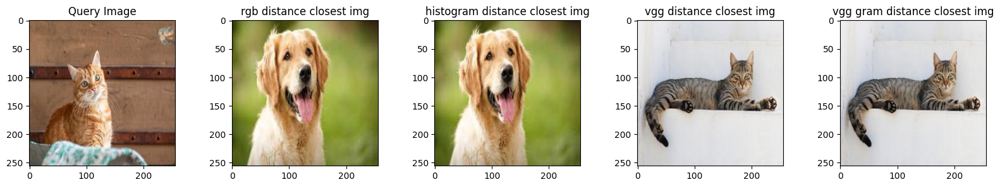

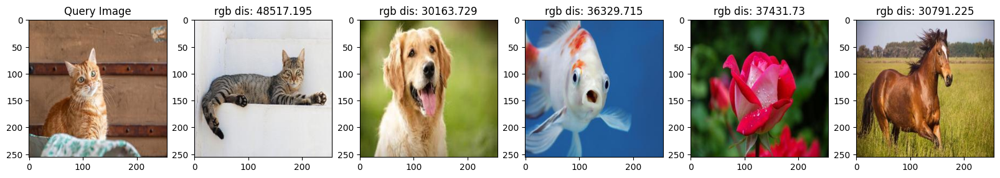

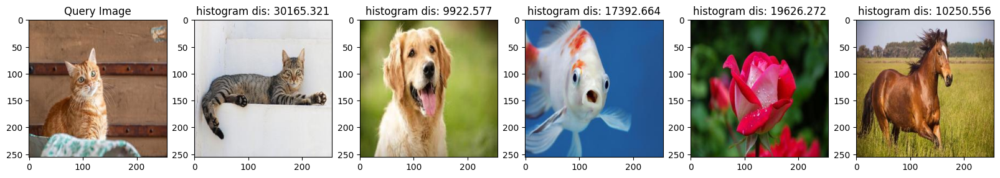

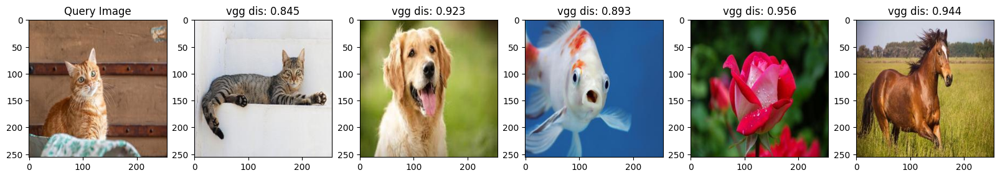

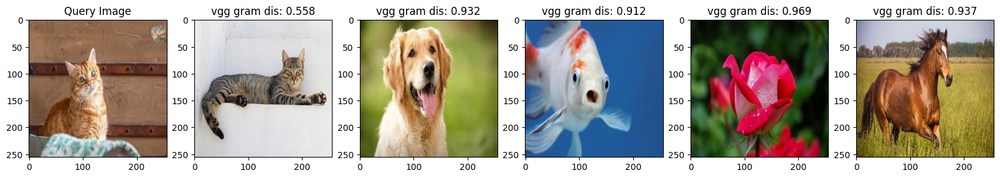

In [73]:
def test_retrieval(query_img, database_imgs_list):
    rgb_distance = [0, 0, 0, 0, 0]
    histogram_distance = [0, 0, 0, 0, 0]
    vgg_distance = [0, 0, 0, 0, 0]
    vgg_gram_distance = [0, 0, 0, 0, 0]

    # you can use the function you implemented above to get the distance to visualize the results
    # nothing here for grade, just for you to debug & visualize
    # ----
    res_rgb, rgb_distance = find_img(query_img, database_imgs_list, mod = 1)
    res_his, histogram_distance = find_img(query_img, database_imgs_list, mod = 2)
    res_vgg, vgg_distance = find_img(query_img, database_imgs_list, mod = 3)
    res_vgg_gram, vgg_gram_distance = find_img(query_img, database_imgs_list, mod = 4)
    # ----

    plt.figure(figsize=(20, 3))
    plt.subplot(1, 5, 1)
    plt.imshow(query_img)
    plt.title('Query Image')
    plt.subplot(1, 5, 2)
    plt.imshow(database_imgs_list[res_rgb])
    plt.title('rgb distance closest img')
    plt.subplot(1, 5, 3)
    plt.imshow(database_imgs_list[res_his])
    plt.title('histogram distance closest img')
    plt.subplot(1, 5, 4)
    plt.imshow(database_imgs_list[res_vgg])
    plt.title('vgg distance closest img')
    plt.subplot(1, 5, 5)
    plt.imshow(database_imgs_list[res_vgg_gram])
    plt.title('vgg gram distance closest img')
    plt.show()


    plt.figure(figsize=(20, 3))
    plt.subplot(1, 6, 1)
    plt.imshow(query_img)
    plt.title('Query Image')
    for i in range(5):
        plt.subplot(1, 6, i + 2)
        plt.imshow(database_imgs_list[i])
        plt.title(f'rgb dis: ' + str(round(rgb_distance[i], 3)))
    plt.show()

    plt.figure(figsize=(20, 3))
    plt.subplot(1, 6, 1)
    plt.imshow(query_img)
    plt.title('Query Image')
    for i in range(5):
        plt.subplot(1, 6, i + 2)
        plt.imshow(database_imgs_list[i])
        plt.title(f'histogram dis: ' + str(round(histogram_distance[i], 3)))
    plt.show()


    plt.figure(figsize=(20, 3))
    plt.subplot(1, 6, 1)
    plt.imshow(query_img)
    plt.title('Query Image')
    for i in range(5):
        plt.subplot(1, 6, i + 2)
        plt.imshow(database_imgs_list[i])
        plt.title(f'vgg dis: ' + str(round(vgg_distance[i], 3)))
    plt.show()

    plt.figure(figsize=(20, 3))
    plt.subplot(1, 6, 1)
    plt.imshow(query_img)
    plt.title('Query Image')
    for i in range(5):
        plt.subplot(1, 6, i + 2)
        plt.imshow(database_imgs_list[i])
        plt.title(f'vgg gram dis: ' + str(round(vgg_gram_distance[i], 3)))
    plt.show()

test_retrieval(query_img, database_imgs_list)

Do not write anything in the cell below, it is for the TAs

In [ ]:
#begin_test


#end_test



**Question 2b**

Choose you methodology which will be tested on a hidden dataset

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>


In [74]:
def get_features_q2b(img):
    """
    Get the features of the image

    Arguments:
    img : an image, PIL image; or a list of images, [PIL image, PIL image, ...]

    Returns:
    features : Features of the image as a numpy array; or a list of features numpy array, [features, features, ...]
    """
    features = None
    #begin_solution

    def gram_matrix(features):
      N, C, H, W = features.size()
      features = features.view(N, C, -1)
      gram = torch.bmm(features, features.transpose(1, 2))
      return gram

    if not isinstance(img, list):
      img = [img]

    mean = [0.485, 0.456, 0.406]
    std = [0.229, 0.224, 0.225]
    preprocess = transforms.Compose([transforms.Resize((224, 224)),transforms.ToTensor(),transforms.Normalize(mean=mean, std=std)])

    processed_img = [preprocess(image) for image in img]
    images_tensor = torch.stack(processed_img).to(device)

    with torch.no_grad():
      feature = vgg(images_tensor)
      features = feature.cpu().numpy()
      features = gram_matrix(feature).cpu().numpy()

    #end_solution

    return features

In [75]:
def find_img_q2b(query_img, database_imgs_list):
    """
    Find the closest image in the database to the query image.

    Arguments:
    query_img: the query image, PIL image
    database_imgs_list : a list of images, [PIL image, PIL image, ...]

    Returns:
    index: the index of the closest image in the database list
    distance_list: the list of distances between the query image and each image in the database list
    """
    index = None
    distance_list = []
    #begin_solution

    batch_size = 16
    query_features = get_features_q2b(query_img).flatten()

    num_images = len(database_imgs_list)
    for start in range(0, num_images, batch_size):
      end = min(start + batch_size, num_images)
      batch_images = database_imgs_list[start:end]

      batch_features = get_features_q2b(batch_images)
      batch_flat = batch_features.reshape(len(batch_images), -1)

      dot_product = np.dot(batch_flat, query_features)
      norm_a = np.linalg.norm(query_features)
      norm_b = np.linalg.norm(batch_flat, axis=1)

      with np.errstate(divide='ignore', invalid='ignore'):
        distances = 1 - (dot_product / (norm_a * norm_b))
        distances[np.isnan(distances)] = 0.0

      distance_list.extend(distances)

    index = np.argmin(distance_list)

    #end_solution

    return index, distance_list

Do not write anything in the cell below, it is for the TAs

In [ ]:
#begin_test


#end_test



**Question 2c**

_Your reply here:_

For four modes mentioned in 2(a):
###RGB Distance:
The RGB distance measures the similarity based on raw pixel values in corresponding channels, but it is sensitive to minor differences like lighting and orientation.

In database_imgs_list, the dog image is selected because it shares similar colour with the query image.

###Histogram Distance:
Histogram distance includes statistics, the color distribution, instead of doing straight pixel by pixel comparison. But still, different objects that share similar colour distribution would be selected.

In database_imgs_list, the dog image is selected because it shares similar colour distribution. The main parts are orange.

###VGG Features:
VGG features give insight on semantic information about image contents, providing meaningful results.

In database_imgs_list, the cat image is selected because it shares similar contents. The main objects are both cats.

###VGG Gram Matrix:
The Gram matrix emphasizes texture and style by capturing correlations between channels. However, it may not value the actual contents as much.

In database_imgs_list, the cat image is selected because the two cats share similar skin texture.

###Conclusion:
Each method has its strengths and weaknesses, leading to different results obtained. Based on the test in 2(a), it can be found that the gram matrix method performs well in given examples. That is why it is selected for 2(b).

In 2(b), the image retrival part is the same as 2(a), but additional batch size is added to avoid lack of memory (in case the dataset is too large to deal with as a whole). 16 is selected as batch size because it is GPU-friendly.

Vectorization is included for both parts of the question to enhance speed.



## 3. Denoising (30 points)
<a name='question3'></a>

[a)](#question4a) Implement `denoiseGauss(image)` to denoise the image `noisy_image.png` under `cw_datasets/Filtering/` using a
5×5 Gaussian filter. (**5 points**)

[b)](#question4b) Implement a convolutional neural network in Pytorch to denoise an image. We provide you pairs of noisy and
noise-free image patches of size 128×128 for training and testing, under `cw_datasets/Denoising/`. You may use all the infrastructure of `Pytorch`. The network should have sufficient depth and complexity to be able to converge well.  Please use ReLU non-linearities after each layer (**20 points**).

[c)](#question4c) Given the comparison between the Gaussian-kernel denoising and the neural network denoising
methods, discuss which method performs better and why. You should write no more than 5 sentences. (**5 points**)


**Question 3a**
<a name='question3a'></a>

Implement the below functions to denoise the image

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [76]:
def gkern(l=5, sig=1.):

    #begin_solution

    ax = np.linspace(-(l // 2), l // 2, l)
    xx, yy = np.meshgrid(ax, ax)
    kernel = np.exp(-(xx**2 + yy**2) / (2 * sig**2))
    out_kernel = kernel / np.sum(kernel)

    #end_solution


    return out_kernel

def denoise_gauss(image):

    #begin_solution

    kernel = gkern(l=5, sig=1.)
    image_array = np.array(image)
    padded_image = np.pad(image_array, ((2, 2), (2, 2), (0, 0)), mode='edge')
    denoised_image = np.zeros_like(image_array)

    for c in range(3):
      for i in range(image_array.shape[0]):
        for j in range(image_array.shape[1]):
          region = padded_image[i:i+5, j:j+5, c]
          denoised_image[i, j, c] = np.sum(region * kernel)

    #end_solution


    return denoised_image

Load input image from file

In [77]:
if drive_mount:
  dataset_path = "/content/drive/MyDrive/cw_datasets/"
else:
  dataset_path = "./cw_datasets/"

noisy_image_filename = os.path.join(dataset_path,"Filtering/noisy_image.png")

Filter the input image

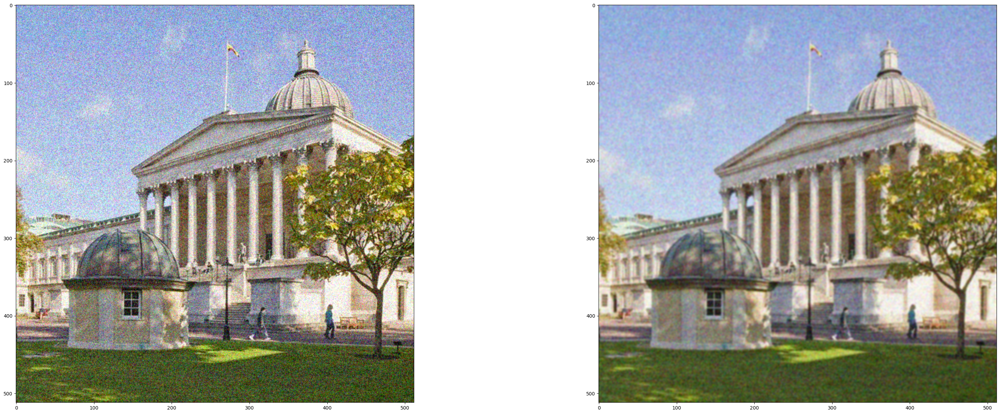

In [78]:
noisy_image = np.asarray(Image.open(noisy_image_filename).convert('RGB'))
denoised_image = denoise_gauss(noisy_image)
plot_images_horizontal([noisy_image, denoised_image])

**Question 3b**
<a name='question3b'></a>

Implement a neural denoiser using Pytorch

Implement dataset class below. Note that the images output by the `DenoisingDB` dataset should be of size 128 x 128. Crop the original images at the top left corner to get the aforementioned size.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [79]:
class DenoisingDB(Dataset):

    def __init__(self, input_imgs_path, cleaned_imgs_path):
        super().__init__()

        #begin_solution
        self.input_imgs_path = input_imgs_path
        self.cleaned_imgs_path = cleaned_imgs_path
        self.input_imgs = sorted(os.listdir(self.input_imgs_path))
        self.cleaned_imgs = sorted(os.listdir(self.cleaned_imgs_path))

        #end_solution


    def __len__(self):
        #begin_solution
        length = len(self.input_imgs)
        #end_solution

        return length

    def __getitem__(self, idx):

        #begin_solution
        input_img_path = os.path.join(self.input_imgs_path, self.input_imgs[idx])
        input_img = Image.open(input_img_path).convert('RGB')
        input_img = input_img.crop((0, 0, 128, 128))

        cleaned_img_path = os.path.join(self.cleaned_imgs_path, self.cleaned_imgs[idx])
        cleaned_img = Image.open(cleaned_img_path).convert('RGB')
        cleaned_img = cleaned_img.crop((0, 0, 128, 128))

        transform = transforms.ToTensor()
        input_img = transform(input_img)
        cleaned_img = transform(cleaned_img)
        #end_solution


        return (input_img, cleaned_img)


Implement the Denoising network:

Note that the network need to be sufficiently complex for performing the denoising task successfully. Feel free to experiment with different layers, blocks and operations.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [80]:
class DenoisingCNN(nn.Module):
    def __init__(self):
        super(DenoisingCNN, self).__init__()

        #begin_solution
        self.initial_layer = nn.Conv2d(3, 64, kernel_size=3, padding=1, bias=False)
        self.second_layer = nn.Conv2d(64, 128, kernel_size=3, padding=1, bias=False)
        self.hidden_layers = nn.ModuleList([nn.Sequential(nn.Conv2d(128, 128, kernel_size=3, padding=1, bias=False),nn.BatchNorm2d(128),nn.ReLU(inplace=True)) for i in range(11)])
        self.final_layer = nn.Conv2d(128, 3, kernel_size=3, padding=1, bias=False)

        #end_solution


    def forward(self, x):

        #begin_solution

        init = x
        x = F.relu(self.initial_layer(x))
        x = F.relu(self.second_layer(x))
        for layer in self.hidden_layers:
          x = layer(x)
        x = self.final_layer(x)
        x = torch.clamp(init - x, 0, 1)

        #end_solution


        return x

# Create an instance of the network
model = DenoisingCNN()


Implement the reconstruction loss

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [85]:
def loss_function(prediction, target):
    """
    Calculate the Mean Squared Error (MSE) loss between the prediction and the target.

    Arguments:
    prediction : torch.Tensor
        The predicted image.
    target : torch.Tensor
        The target image for reconstruction.

    Returns:
    loss : torch.Tensor
        The computed loss.
    """

    #begin_solution
    loss = F.mse_loss(prediction, target)
    #end_solution


    return loss


Paths to input data

In [81]:
if drive_mount:
  dataset_path = "/content/drive/MyDrive/cw_datasets/"
else:
  dataset_path = "./cw_datasets/"

input_imgs_path = os.path.join(dataset_path,"Denoising/input_noisy_images/")
cleaned_imgs_path = os.path.join(dataset_path,"Denoising/target_clean_images/")

Write the training loop

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [88]:
#begin_solution

learning_rate = 0.001
batch_size = 16
num_epochs = 50

denoising_dataset = DenoisingDB(input_imgs_path, cleaned_imgs_path)
train_loader = DataLoader(denoising_dataset, batch_size=batch_size, shuffle=True)

denoiser = DenoisingCNN().to(device)
criterion = loss_function
optimizer = optim.Adam(denoiser.parameters(), lr=learning_rate)

for epoch in range(num_epochs):
  denoiser.train()
  running_loss = 0.0

  for inputs, targets in train_loader:
    inputs, targets = inputs.to(device), targets.to(device)

    optimizer.zero_grad()

    outputs = denoiser(inputs)

    loss = criterion(outputs, targets)

    loss.backward()
    optimizer.step()

    running_loss += loss.item()

  avg_loss = running_loss / len(train_loader)

  print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {avg_loss:.4f}')

#end_solution





Epoch [1/50], Loss: 0.0509
Epoch [2/50], Loss: 0.0050
Epoch [3/50], Loss: 0.0040
Epoch [4/50], Loss: 0.0034
Epoch [5/50], Loss: 0.0029
Epoch [6/50], Loss: 0.0028
Epoch [7/50], Loss: 0.0025
Epoch [8/50], Loss: 0.0020
Epoch [9/50], Loss: 0.0015
Epoch [10/50], Loss: 0.0013
Epoch [11/50], Loss: 0.0011
Epoch [12/50], Loss: 0.0009
Epoch [13/50], Loss: 0.0009
Epoch [14/50], Loss: 0.0008
Epoch [15/50], Loss: 0.0008
Epoch [16/50], Loss: 0.0007
Epoch [17/50], Loss: 0.0007
Epoch [18/50], Loss: 0.0006
Epoch [19/50], Loss: 0.0006
Epoch [20/50], Loss: 0.0006
Epoch [21/50], Loss: 0.0005
Epoch [22/50], Loss: 0.0005
Epoch [23/50], Loss: 0.0005
Epoch [24/50], Loss: 0.0005
Epoch [25/50], Loss: 0.0004
Epoch [26/50], Loss: 0.0005
Epoch [27/50], Loss: 0.0004
Epoch [28/50], Loss: 0.0004
Epoch [29/50], Loss: 0.0004
Epoch [30/50], Loss: 0.0004
Epoch [31/50], Loss: 0.0004
Epoch [32/50], Loss: 0.0004
Epoch [33/50], Loss: 0.0004
Epoch [34/50], Loss: 0.0003
Epoch [35/50], Loss: 0.0004
Epoch [36/50], Loss: 0.0003
E

Save the model (needed for marking)

In [89]:
if not os.path.exists("models/"):
  os.makedirs("./models/")
torch.save({"denoiser":denoiser}, "models/denoiser.pth")

Load trained model

In [90]:
state_dict = torch.load("models/denoiser.pth")
denoiser = state_dict["denoiser"].to(device)

<ipython-input-90-8ea245196597>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("models/denoiser.pth")


Plot 5 input images and their relative denoised images side by side. Populate the 3 lists of input, gt and output with 5 images each.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

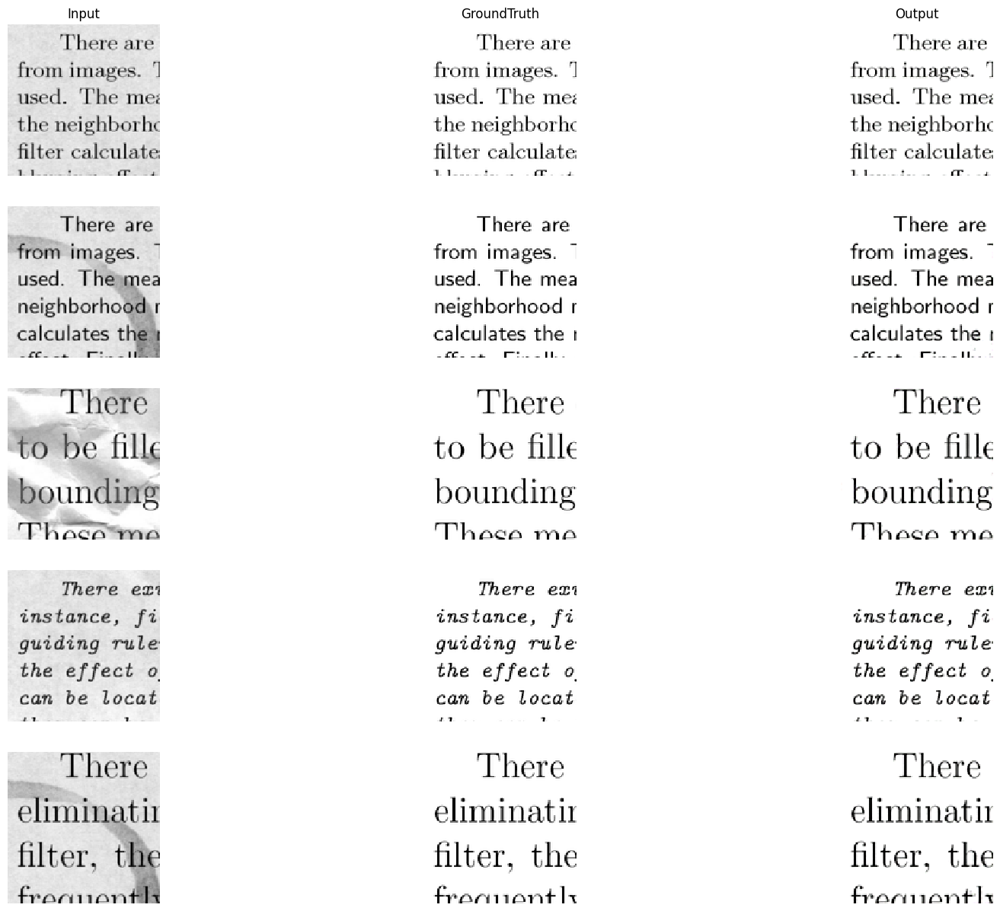

In [92]:
input_imgs, gt_imgs, output_imgs = [], [], []

#begin_solution
dataset = DenoisingDB(input_imgs_path, cleaned_imgs_path)
dataloader = DataLoader(dataset, batch_size=5, shuffle=True)
for inputs, targets in dataloader:
  inputs, targets = inputs.to(device), targets.to(device)
  outputs = denoiser(inputs)

  input_imgs = [img.detach().cpu().permute(1, 2, 0).numpy() for img in inputs]
  gt_imgs = [img.detach().cpu().permute(1, 2, 0).numpy() for img in targets]
  output_imgs = [img.detach().cpu().permute(1, 2, 0).numpy() for img in outputs]
  break

#end_solution


titles = ['Input', 'GroundTruth', 'Output']
plot_images_with_text([input_imgs, gt_imgs, output_imgs],titles,texts=None)


Compute images for both the AE and Gaussian Kernels algorithm from `images`.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [93]:
dataset = DenoisingDB(input_imgs_path,cleaned_imgs_path)

images = [dataset[i][0].to(device) for i in range(5)]
targets = [dataset[i][1].to(device) for i in range(5)]
images_ae = []
images_gauss = []

#begin_solution

for img, target in zip(images, targets):
  img = img.to(device)

  with torch.no_grad():
    denoised_ae = denoiser(img.unsqueeze(0))

    images_ae.append(np.transpose(denoised_ae.squeeze(0).cpu().numpy(), (1, 2, 0)))

  img_np = img.permute(1, 2, 0).cpu().numpy()
  denoised_gauss = denoise_gauss(img_np)

  images_gauss.append(denoised_gauss)

images = [image.permute(1, 2, 0) for image in images]
targets = [target.permute(1, 2, 0) for target in targets]

#end_solution


Now we plot images and PSNR, to compare the two methods

In [94]:
imgs_plot = [ el.detach().squeeze().cpu().numpy() for el in images]
tgts_plot = [ el.detach().squeeze().cpu().numpy() for el in targets]

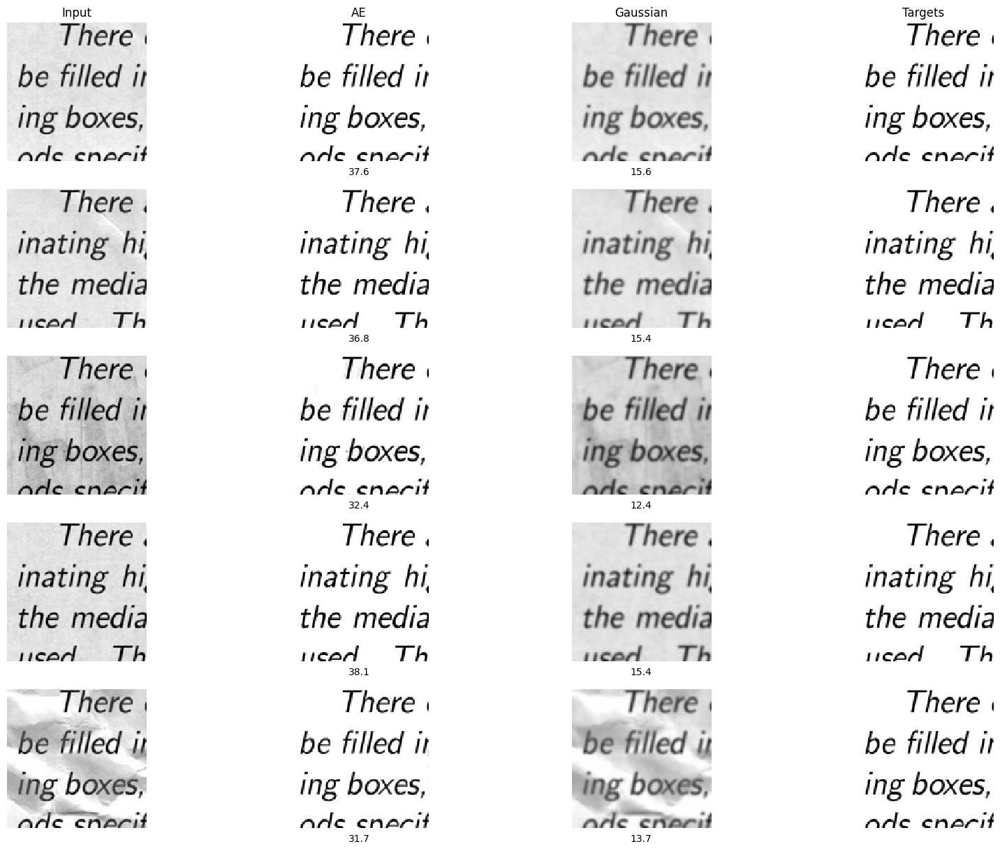

In [95]:
psnrs = [ 0.0 for el in targets ]
for i in range(len(tgts_plot)):
    psnr_ae    = peak_signal_noise_ratio(tgts_plot[i], images_ae[i])
    pnsr_gauss = peak_signal_noise_ratio(tgts_plot[i], images_gauss[i])
    psnrs[i] = ['', psnr_ae, pnsr_gauss, '']



img = [imgs_plot, images_ae, images_gauss, tgts_plot]
titles = ['Input', 'AE', 'Gaussian', 'Targets']
texts = psnrs
plot_images_with_text(img, titles, texts)
plt.show()

**Question 3c**
<a name="question3c"></a>

#### Discuss which method performs better, and why, edit the cell below with "Your reply" ####

_Your reply here:_



The neural network denoising method generally outperforms Gaussian kernel denoising method, since it can successfully eliminate wrinkles (noise) and unwanted background colour.

The PSNR for neural network method is significantly larger than the PSNR for Gaussian kernel, indicating better image quality.

The neural network contains multiple layers, large number of channels (128 used) and non-linearities, so that it is capable of learning complex, data-driven patterns specific to the noise and retaining important features of the input images.

In contrast, Gaussian kernel denoising uses a fixed 5*5 filter that applies a uniform smoothing effect, which may blur details, and fail to clean background colour.

Therefore, Gaussian denoising lacks the adaptability of neural networks and is limited in its ability to preserve detailed images.

## 4. Texture Synthesis (15 points)
We ask you to perform operations on image styles for this task.

You know that style is captured in the statistics of visual features. We want you to extract different statistics and apply that to texture synthesis. Texture synthesis are images with no content, only style.

[a)](#question4a) Write code to extract means, variance and gram matrices of the style from an exemplar image. We will test this with hidden styles/textures. **(3 points)**

[b)](#question4b) Generate a texture by optimizing image pixels for a given statistics. We will test this with our hidden texture as well. **(6 points)**

[c)](#question4c) How can you improve the starting input to get more visually appealing results. **(1 points )**

[d)](#question4d) Find us a non-trivial texture that looks acceptable in mean, but not in other. **(1 points )**

[e)](#question4e) Find us a non-trivial texture that looks acceptable only in gram. **(1 points )**

[f)](#question4f) Failure case. We give you an exemplar with regular patterns. It fails. Can you fix it? perform your own research and explain. **(2 points )**

[g)](#question4f) How can you use the answer of this section to generate a good hidden test image for Question 2. Write no more than one sentence. **(1 points )**

In [96]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn = models.vgg19(weights=models.VGG19_Weights.DEFAULT).features.to(device).eval()
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)
unloader = transforms.ToPILImage()

def load_image(image_path, transform):
    image = Image.open(image_path).convert("RGB")
    image = transform(image).unsqueeze(0)
    return image.to(device)

def unload_image(tensor, title=None):
    image = tensor.cpu().clone().squeeze(0)
    image = unloader(image)
    return image

**Question 4a**
<a name='question4a'></a>

Write code to extract means, variance and gram matrices of the style layers from an example image. We will test this with hidden styles/textures.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [97]:
def get_vgg_gram_matrix(input):
    pass
    #begin_solution

    _, c, h, w = input.size()
    features = input.view(c, h * w)
    gram_matrix = torch.mm(features, features.t()) / (c * h * w)
    return gram_matrix

    #end_solution



def get_vgg_mean(input):
    pass
    #begin_solution
    mean = input.mean(dim=(2, 3), keepdim=True)
    return mean

    #end_solution



def get_vgg_var(input):
    pass
    #begin_solution

    var = input.var(dim=(2, 3), keepdim=True)
    return var

    #end_solution



class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        pass
        #begin_solution

        self.mean = mean.view(-1, 1, 1).to(device)
        self.std = std.view(-1, 1, 1).to(device)

        #end_solution


    def forward(self, img):
        # Return the normalized image based on VGG19 mean and variance
        pass
        #begin_solution

        return (img - self.mean) / self.std

        #end_solution



class StyleFeaturesExtractor:
    def __init__(self, cnn, style_img, normalization_mean, normalization_std, num_layers=10):
        """
        A class to extract style features from a pre-trained VGG19

        Attributes:
        -----------
        cnn : torch.nn.Module -- pre-trained VGG19

        style_img : torch.Tensor

        normalization_mean : torch.Tensor
            The mean tensor for normalizing the input image.

        normalization_std : torch.Tensor
            The standard deviation tensor for normalizing the input image.

        num_layers : int, optional
            The number of convolutional layers from which style features will be extracted.
            Default is 10.

        model : torch.nn.Sequential
            The model built up to the specified number of layers, including normalization.
            This model will be used for extracting features.

        style_features : dict
            A dictionary to store the extracted style features from different VGG layers.
        """

        self.cnn = cnn
        self.style_img = style_img
        self.normalization_mean = normalization_mean
        self.normalization_std = normalization_std
        self.num_layers = num_layers
        self.model = None
        self.style_features = {}
        self.build_model_and_extract_features()

    def build_model_and_extract_features(self):
        """
        Write your implementation here.

        You have to compute the following.

        1. style_features: a dictionary with the layer indices as keys (int) and the values being another dictionary.
            The nested part of the dictionary has the following structure:
            {
                'gram': torch.Tensor stores the gram matrix of the layer features,
                'mean': torch.Tensor stores the mean of the layer features along 3rd and 4th dimension (keep all dimensions of the original, do not squeeze/shrink),
                'var': torch.Tensor stores the variance of the layer features along 3rd and 4th dimension (keep all dimensions of the original, do not squeeze/shrink)
            }
            Eg: {0: {'gram': torch.Tensor, 'mean': torch.Tensor, 'var': torch.Tensor}, 1: {'gram': torch.Tensor, 'mean': torch.Tensor, 'var': torch.Tensor}, ... 10: {'gram': torch.Tensor, 'mean': torch.Tensor, 'var': torch.Tensor}}

        2. Build the model upto self.num_layers of VGG19 (this will be a partial version of VGG 19 as we do not want to extract features from all layers).
        """

        normalization = Normalization(self.normalization_mean, self.normalization_std).to(device)
        model = nn.Sequential(normalization)
        style_features = {}

        #begin_solution

        x = self.style_img
        index = 0

        cnn_layers = list(self.cnn.children())
        while index < len(cnn_layers) and index < self.num_layers:
          layer = cnn_layers[index]
          model.add_module(str(index), layer)

          if isinstance(layer, nn.Conv2d):
            x = layer(x)
            style_features[index] = {'gram': get_vgg_gram_matrix(x), 'mean': get_vgg_mean(x), 'var': get_vgg_var(x)}

          elif isinstance(layer, nn.ReLU):
            x = F.relu(x, inplace=False)
            style_features[index] = {'gram': get_vgg_gram_matrix(x), 'mean': get_vgg_mean(x), 'var': get_vgg_var(x)}

          elif isinstance(layer, nn.MaxPool2d):
            x = F.avg_pool2d(x, kernel_size=2, padding=0, stride=2)
            style_features[index] = {'gram': get_vgg_gram_matrix(x), 'mean': get_vgg_mean(x), 'var': get_vgg_var(x)}

          index += 1

        #end_solution


        self.model = model
        self.style_features = style_features

Do not write anything the cell below, it is for TAs

In [ ]:
#begin_test


#end_test



**Question 4b**
<a name='question4b'></a>

Implement code to generate a texture by optimizing image pixels for a given statistics. We will test this with our hidden texture, too.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [98]:
class StyleLoss(nn.Module):
    def __init__(self, target_feature, loss_method="gram"):
        super(StyleLoss, self).__init__()
        self.loss_method = loss_method
        self.loss = 0

        if self.loss_method == "gram":
            self.target = target_feature['gram'].detach()
        elif self.loss_method == "mean_var":
            self.target_mean = target_feature['mean'].detach()
            self.target_var = target_feature['var'].detach()
        else:
            raise ValueError("Invalid loss_method. Choose 'gram' or 'mean_var'.")

    def forward(self, input):
        # Depending on self.loss_method (either "gram" or "mean_var") compute the loss of input features statistics to that of the target
        # Store the computed loss in self.loss
        # Do NOT change input. Simply use it to compute stats and the loss accordingly.

        # self.loss = ?

        pass

        #begin_solution

        if self.loss_method == "gram":
          input_gram_flat = get_vgg_gram_matrix(input).view(-1)
          target_gram_flat = self.target.view(-1)
          self.loss = 1 - F.cosine_similarity(input_gram_flat, target_gram_flat, dim=0)

        elif self.loss_method == "mean_var":
          mean_loss = 1 - F.cosine_similarity(get_vgg_mean(input), self.target_mean, dim=1).mean()
          var_loss = 1 - F.cosine_similarity(get_vgg_var(input), self.target_var, dim=1).mean()
          self.loss = mean_loss + var_loss

        #end_solution


        return input

Implement the optimization functions to updates the input image (noise) to match the style of the reference image.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [99]:
def get_input_optimizer(input_img):
    optimizer = optim.LBFGS([input_img.requires_grad_()])
    return optimizer

def get_style_model_and_losses(
    style_features_extractor,
    loss_method="gram",
):
    """
    Builds a new model based on the style features extracted from the pre-trained VGG.
    It replaces ReLU layers with out-of-place ReLU operations and adds style loss layers
    based on the features extracted from the style image (TODO).

    Parameters:
    -----------
    style_features_extractor : StyleFeaturesExtractor
        An instance of `StyleFeaturesExtractor` that contains the truncated model and
        extracted style features for each layer.

    loss_method : str, optional
        The method used for calculating the style loss. Default is "gram".

    Returns:
    --------
    new_model : torch.nn.Sequential
        A sequential model consisting of the layers up to the desired depth, including
        the necessary style loss layers.

    style_losses : list
        A list of `StyleLoss` modules that will be used to compute the style loss during optimization.
    """

    model = style_features_extractor.model
    style_losses = []
    new_model = nn.Sequential()

    for idx, layer in enumerate(model):
        if isinstance(layer, nn.ReLU):
            layer = nn.ReLU(inplace=False)
        new_model.add_module(str(idx), layer)

    #begin_solution
        if idx in style_features_extractor.style_features:
          target_feature = style_features_extractor.style_features[idx]
          style_loss = StyleLoss(target_feature, loss_method=loss_method)
          new_model.add_module(f"style_loss_{idx}", style_loss)
          style_losses.append(style_loss)

    #end_solution


    return new_model, style_losses


def run_texture_synthesis(
    style_features_extractor,
    input_img,
    num_steps=2000,
    loss_method="gram",
):
    """
    Runs the texture synthesis optimization process by applying style transfer
    based on the extracted style features. This function updates the input image to
    match the style of the reference image. You can use the optimizer provided in get_input_optimizer

    Parameters:
    -----------
    style_features_extractor : StyleFeaturesExtractor
        An instance of the StyleFeaturesExtractor class that contains the model
        and extracted style features.

    input_img : torch.Tensor
        The input image tensor (initially random noise)
        that will be updated during the optimization process.

    num_steps : int, optional
        The number of optimization steps to run. Default is 2000.

    loss_method : str, optional
        The method used for calculating the style loss. Default is "gram".

    Returns:
    --------
    input_img : torch.Tensor
        The input image tensor that has been updated to match the style of the reference image.
    """

    model, style_losses = get_style_model_and_losses(
        style_features_extractor, loss_method=loss_method
    )

    #begin_solution

    optimizer = get_input_optimizer(input_img)

    history = []

    run = [0]
    while run[0] <= num_steps:

      def closure():
        input_img.data.clamp_(0, 1)
        optimizer.zero_grad()
        torch.nn.utils.clip_grad_norm_(input_img, max_norm=10)

        model(input_img)
        style_score = 0

        for sl in style_losses:
          style_score += sl.loss

        if not torch.isfinite(style_score):
          input_img.data = torch.randn_like(input_img) * 0.1
          return torch.tensor(float('inf'))
        style_score.backward()

        history.append(style_score.item())

        if len(history) > 10 and style_score.item() > min(history[-10:]) * 1.5:
          for param_group in optimizer.param_groups:
            param_group['lr'] *= 0.5

        run[0] += 1
        if run[0] % 50 == 0:
          print(f"Step {run[0]}, Style Loss: {style_score.item()}")

        return style_score

      optimizer.step(closure)


    input_img.data.clamp_(0, 1)

    #end_solution

    return input_img

We will use the following style image to sythesize textures from

--2024-11-04 13:39:45--  https://upload.wikimedia.org/wikipedia/en/thumb/8/8f/Pablo_Picasso%2C_1909-10%2C_Figure_dans_un_Fauteuil_%28Seated_Nude%2C_Femme_nue_assise%29%2C_oil_on_canvas%2C_92.1_x_73_cm%2C_Tate_Modern%2C_London.jpg/919px-Pablo_Picasso%2C_1909-10%2C_Figure_dans_un_Fauteuil_%28Seated_Nude%2C_Femme_nue_assise%29%2C_oil_on_canvas%2C_92.1_x_73_cm%2C_Tate_Modern%2C_London.jpg?20150127060348
Resolving upload.wikimedia.org (upload.wikimedia.org)... 103.102.166.240, 2001:df2:e500:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|103.102.166.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 282672 (276K) [image/jpeg]
Saving to: ‘picasso.jpg’

picasso.jpg         100%[===================>] 276.05K  --.-KB/s    in 0.009s  

2024-11-04 13:39:45 (30.8 MB/s) - ‘picasso.jpg’ saved [282672/282672]



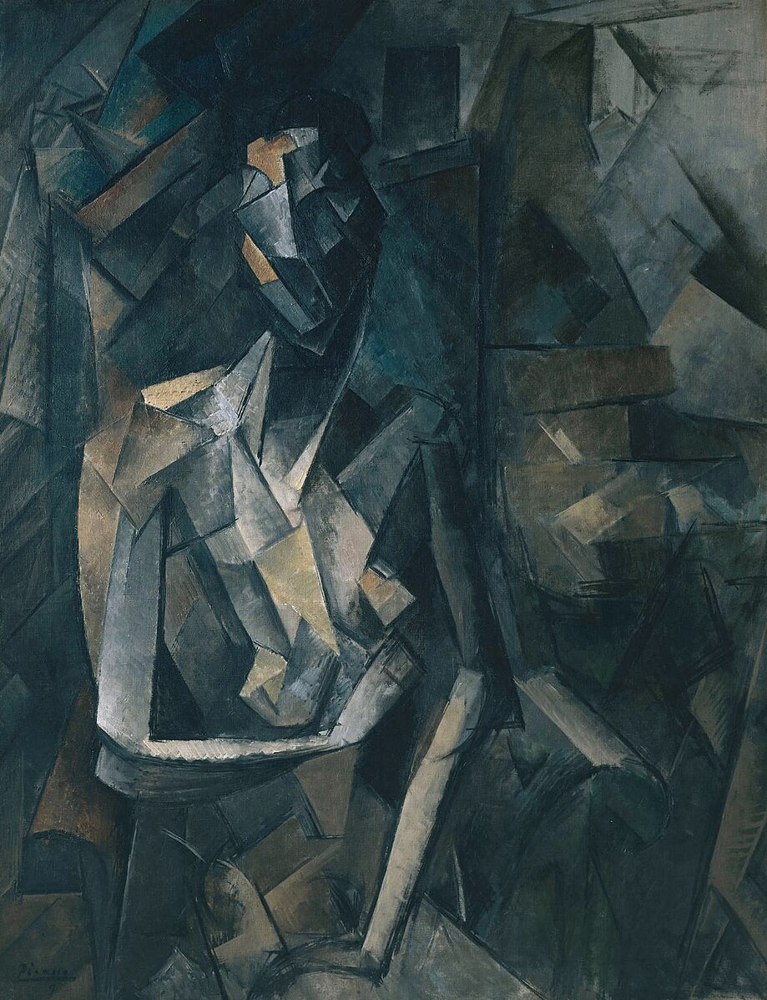

In [100]:
! wget "https://upload.wikimedia.org/wikipedia/en/thumb/8/8f/Pablo_Picasso%2C_1909-10%2C_Figure_dans_un_Fauteuil_%28Seated_Nude%2C_Femme_nue_assise%29%2C_oil_on_canvas%2C_92.1_x_73_cm%2C_Tate_Modern%2C_London.jpg/919px-Pablo_Picasso%2C_1909-10%2C_Figure_dans_un_Fauteuil_%28Seated_Nude%2C_Femme_nue_assise%29%2C_oil_on_canvas%2C_92.1_x_73_cm%2C_Tate_Modern%2C_London.jpg?20150127060348" -O picasso.jpg

image_size = 256
loader = transforms.Compose(
    [transforms.Resize((image_size, image_size)), transforms.ToTensor()]
)
style_image_path = "./picasso.jpg"
Image.open(style_image_path)


Do not write anything the cell below, it is for TAs

In [ ]:
#begin_test


#end_test



Now it's time to test your code on texture synthesis

Generate texture using mean and variance of features

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

Step 50, Style Loss: 0.89701247215271
Step 100, Style Loss: 0.20162200927734375
Step 150, Style Loss: 0.13212382793426514
Step 200, Style Loss: 0.10361623764038086
Step 250, Style Loss: 0.08459597826004028
Step 300, Style Loss: 0.07567328214645386
Step 350, Style Loss: 0.07168322801589966
Step 400, Style Loss: 0.06926190853118896
Step 450, Style Loss: 0.06762665510177612
Step 500, Style Loss: 0.06642824411392212
Step 550, Style Loss: 0.06550180912017822
Step 600, Style Loss: 0.06471872329711914
Step 650, Style Loss: 0.06403911113739014
Step 700, Style Loss: 0.06344521045684814
Step 750, Style Loss: 0.06288957595825195
Step 800, Style Loss: 0.062372446060180664
Step 850, Style Loss: 0.061899006366729736
Step 900, Style Loss: 0.06146681308746338
Step 950, Style Loss: 0.06105464696884155
Step 1000, Style Loss: 0.06066083908081055
Step 1050, Style Loss: 0.06028634309768677
Step 1100, Style Loss: 0.059917151927948
Step 1150, Style Loss: 0.05957937240600586
Step 1200, Style Loss: 0.059244453

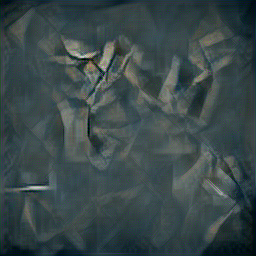

In [101]:
style_img = load_image(style_image_path, loader)
input_img = torch.randn(style_img.data.size(), device=device)
loss_method = "mean_var"

#begin_solution
style_features_extractor = StyleFeaturesExtractor(
  cnn=cnn,
  style_img=style_img,
  normalization_mean=cnn_normalization_mean,
  normalization_std=cnn_normalization_std,
  num_layers=17
)

output_img = run_texture_synthesis(style_features_extractor, input_img, num_steps=2000, loss_method=loss_method)
unload_image(output_img)

#end_solution


Generate texture using gram matrix

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

Step 50, Style Loss: 0.7199450731277466
Step 100, Style Loss: 0.17402499914169312
Step 150, Style Loss: 0.0976068377494812
Step 200, Style Loss: 0.07657819986343384
Step 250, Style Loss: 0.06839615106582642
Step 300, Style Loss: 0.06388324499130249
Step 350, Style Loss: 0.06060206890106201
Step 400, Style Loss: 0.058225035667419434
Step 450, Style Loss: 0.0564231276512146
Step 500, Style Loss: 0.05488467216491699
Step 550, Style Loss: 0.05348688364028931
Step 600, Style Loss: 0.05222773551940918
Step 650, Style Loss: 0.05105620622634888
Step 700, Style Loss: 0.05001753568649292
Step 750, Style Loss: 0.04910409450531006
Step 800, Style Loss: 0.04831749200820923
Step 850, Style Loss: 0.04765617847442627
Step 900, Style Loss: 0.04705697298049927
Step 950, Style Loss: 0.046605825424194336
Step 1000, Style Loss: 0.04613626003265381
Step 1050, Style Loss: 0.0457800030708313
Step 1100, Style Loss: 0.04546421766281128
Step 1150, Style Loss: 0.04518204927444458
Step 1200, Style Loss: 0.04493945

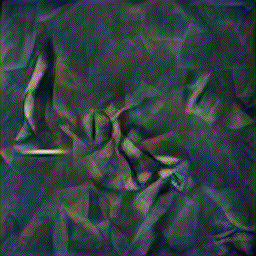

In [102]:
style_img = load_image(style_image_path, loader)
input_img = torch.randn(style_img.data.size(), device=device)

loss_method = "gram"

#begin_solution

style_features_extractor = StyleFeaturesExtractor(
  cnn=cnn,
  style_img=style_img,
  normalization_mean=cnn_normalization_mean,
  normalization_std=cnn_normalization_std,
  num_layers=17
)

output_img = run_texture_synthesis(style_features_extractor, input_img, num_steps=2000, loss_method=loss_method)
unload_image(output_img)
#end_solution


**Question 4c**
<a name='question4c'></a>

How can you improve the starting input to get more visually appealing results. Think about what you've learnt and implemented till now.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

Step 50, Style Loss: 0.5004199743270874
Step 100, Style Loss: 0.11083251237869263
Step 150, Style Loss: 0.07005941867828369
Step 200, Style Loss: 0.05899089574813843
Step 250, Style Loss: 0.05553919076919556
Step 300, Style Loss: 0.053614675998687744
Step 350, Style Loss: 0.0522955060005188
Step 400, Style Loss: 0.05127155780792236
Step 450, Style Loss: 0.050505995750427246
Step 500, Style Loss: 0.04990023374557495
Step 550, Style Loss: 0.04941868782043457
Step 600, Style Loss: 0.049037039279937744
Step 650, Style Loss: 0.04870867729187012
Step 700, Style Loss: 0.04841041564941406
Step 750, Style Loss: 0.04814112186431885
Step 800, Style Loss: 0.047886013984680176
Step 850, Style Loss: 0.047657907009124756
Step 900, Style Loss: 0.04743027687072754
Step 950, Style Loss: 0.04722708463668823
Step 1000, Style Loss: 0.047027766704559326
Step 1050, Style Loss: 0.04684561491012573
Step 1100, Style Loss: 0.04667001962661743
Step 1150, Style Loss: 0.04650223255157471
Step 1200, Style Loss: 0.04

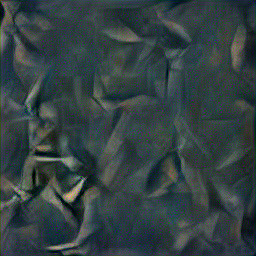

In [103]:
style_img = load_image(style_image_path, loader)
input_img = torch.randn(style_img.data.size(), device=device)

loss_method = "gram"

#begin_solution

input_img = torch.nn.functional.interpolate(input_img, scale_factor=0.5, mode='bilinear')
input_img = torch.nn.functional.interpolate(input_img, size=style_img.shape[-2:])

style_features_extractor = StyleFeaturesExtractor(
  cnn=cnn,
  style_img=style_img,
  normalization_mean=cnn_normalization_mean,
  normalization_std=cnn_normalization_std,
  num_layers=17
)

output_img = run_texture_synthesis(style_features_extractor, input_img, num_steps=2000, loss_method=loss_method)
unload_image(output_img)


#end_solution


**Question 4d**
<a name='question4d'></a>

Find us a non-trivial texture that looks acceptable in mean, but not in gram.


Your answer


&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

--2024-11-03 13:50:46--  https://th.bing.com/th/id/OIP.rpseUp-QuSbZ5DqzWMgYYAHaE8?rs=1&pid=ImgDetMain
Resolving th.bing.com (th.bing.com)... 23.60.173.56, 23.60.173.81, 23.60.173.67, ...
Connecting to th.bing.com (th.bing.com)|23.60.173.56|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46832 (46K) [image/jpeg]
Saving to: ‘gram_texture.jpg’

gram_texture.jpg    100%[===================>]  45.73K  --.-KB/s    in 0.01s   

2024-11-03 13:50:47 (4.52 MB/s) - ‘gram_texture.jpg’ saved [46832/46832]

Mean and Variance:
Step 50, Style Loss: 0.5120744109153748
Step 100, Style Loss: 0.2216320037841797
Step 150, Style Loss: 0.1804679036140442
Step 200, Style Loss: 0.16645950078964233
Step 250, Style Loss: 0.15887629985809326
Step 300, Style Loss: 0.1537017822265625
Step 350, Style Loss: 0.1494663953781128
Step 400, Style Loss: 0.14565032720565796
Step 450, Style Loss: 0.1420091986656189
Step 500, Style Loss: 0.1384141445159912
Step 550, Style Loss: 0.13479548692703247
St

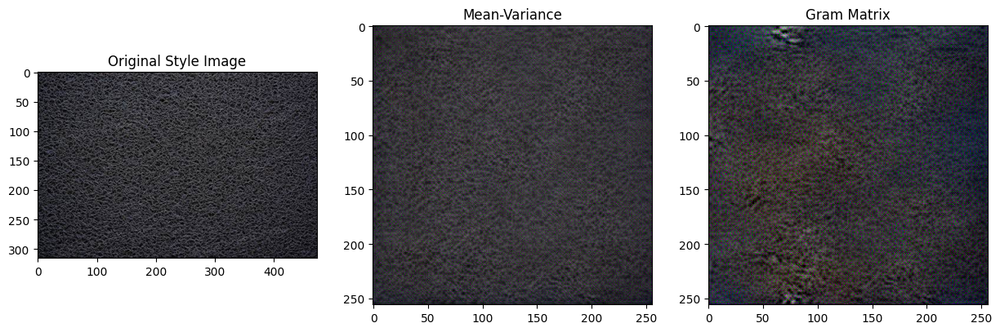

In [ ]:
#begin_solution

! wget "https://th.bing.com/th/id/OIP.rpseUp-QuSbZ5DqzWMgYYAHaE8?rs=1&pid=ImgDetMain" -O d.jpg


image_size = 256
loader = transforms.Compose([transforms.Resize((image_size, image_size)), transforms.ToTensor()])
style_image_path_3 = "./d.jpg"
original_image = Image.open(style_image_path_3)

style_img = load_image(style_image_path_3, loader)
input_img = torch.randn(style_img.data.size(), device=device)
input_img = torch.nn.functional.interpolate(input_img, scale_factor=0.5, mode='bilinear')
input_img = torch.nn.functional.interpolate(input_img, size=style_img.shape[-2:])

print("Mean and Variance:")
style_features_extractor = StyleFeaturesExtractor(cnn, style_img, cnn_normalization_mean, cnn_normalization_std, num_layers=17)
output_img_mean_var = run_texture_synthesis(style_features_extractor, input_img, num_steps=1000, loss_method="mean_var")
mean_var_image = unload_image(output_img_mean_var)

print("Gram:")
style_features_extractor = StyleFeaturesExtractor(cnn, style_img, cnn_normalization_mean, cnn_normalization_std, num_layers=17)
output_img_mean_var2 = run_texture_synthesis(style_features_extractor, input_img, num_steps=1000, loss_method="gram")
gram_image = unload_image(output_img_mean_var2)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(original_image)
axes[0].set_title("Original Style Image")
axes[1].imshow(mean_var_image)
axes[1].set_title("Mean-Variance")
axes[2].imshow(gram_image)
axes[2].set_title("Gram Matrix")

plt.show()

#end_solution


**Question 4e**
<a name='question4e'></a>

Find us a non-trivial texture that looks acceptable in only gram.

Your answer

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

--2024-11-03 14:00:40--  https://th.bing.com/th/id/OIP.xdBFMn6zz-ok4uBw5G1dpgHaH6?pid=ImgDet&w=181&h=193&c=7&dpr=1.5
Resolving th.bing.com (th.bing.com)... 23.60.173.26, 23.60.173.67, 23.60.173.48, ...
Connecting to th.bing.com (th.bing.com)|23.60.173.26|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24540 (24K) [image/jpeg]
Saving to: ‘gram_texture.jpg’

gram_texture.jpg    100%[===================>]  23.96K  --.-KB/s    in 0.007s  

2024-11-03 14:00:40 (3.13 MB/s) - ‘gram_texture.jpg’ saved [24540/24540]

Mean and Variance:
Step 50, Style Loss: 0.16278904676437378
Step 100, Style Loss: 0.07580536603927612
Step 150, Style Loss: 0.06185716390609741
Step 200, Style Loss: 0.05508655309677124
Step 250, Style Loss: 0.06155472993850708
Step 300, Style Loss: 0.05830103158950806
Step 350, Style Loss: 0.07352316379547119
Step 400, Style Loss: 0.0698162317276001
Step 450, Style Loss: 0.09342014789581299
Step 500, Style Loss: 0.10137665271759033
Step 550, Style Loss: 0

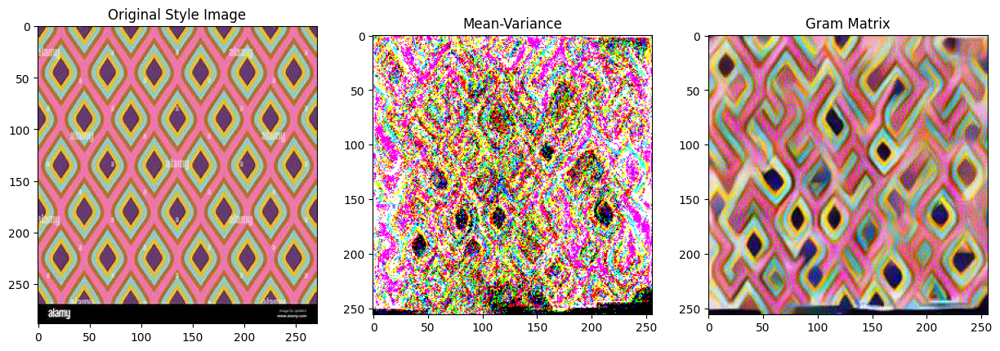

In [ ]:
#begin_solution
! wget "https://th.bing.com/th/id/OIP.xdBFMn6zz-ok4uBw5G1dpgHaH6?pid=ImgDet&w=181&h=193&c=7&dpr=1.5" -O e.jpg

image_size = 256
loader = transforms.Compose([transforms.Resize((image_size, image_size)), transforms.ToTensor()])
style_image_path_3 = "./e.jpg"
original_image = Image.open(style_image_path_3)

style_img = load_image(style_image_path_3, loader)
input_img = torch.randn(style_img.data.size(), device=device)
input_img = torch.nn.functional.interpolate(input_img, scale_factor=0.5, mode='bilinear')
input_img = torch.nn.functional.interpolate(input_img, size=style_img.shape[-2:])

print("Mean and Variance:")
style_features_extractor = StyleFeaturesExtractor(cnn, style_img, cnn_normalization_mean, cnn_normalization_std, num_layers=17)
output_img_mean_var = run_texture_synthesis(style_features_extractor, input_img, num_steps=1000, loss_method="mean_var")
mean_var_image = unload_image(output_img_mean_var)

print("Gram:")
style_features_extractor = StyleFeaturesExtractor(cnn, style_img, cnn_normalization_mean, cnn_normalization_std, num_layers=17)
output_img_mean_var2 = run_texture_synthesis(style_features_extractor, input_img, num_steps=1000, loss_method="gram")
gram_image = unload_image(output_img_mean_var2)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(original_image)
axes[0].set_title("Original Style Image")
axes[1].imshow(mean_var_image)
axes[1].set_title("Mean-Variance")
axes[2].imshow(gram_image)
axes[2].set_title("Gram Matrix")


plt.show()

#end_solution

**Question 4f**
<a name='question4f'></a>

Failure case.
We give you an exemplar with regular patterns. It fails. Can you fix it? Explain why.

--2024-11-04 13:48:58--  https://i.pinimg.com/1200x/d7/ab/78/d7ab78073fa05268a02f9b381064364b.jpg
Resolving i.pinimg.com (i.pinimg.com)... 151.101.0.84, 151.101.64.84, 151.101.128.84, ...
Connecting to i.pinimg.com (i.pinimg.com)|151.101.0.84|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 56315 (55K) [image/jpeg]
Saving to: ‘regular_pattern.png’

regular_pattern.png 100%[===================>]  55.00K  --.-KB/s    in 0.002s  

2024-11-04 13:48:58 (29.4 MB/s) - ‘regular_pattern.png’ saved [56315/56315]



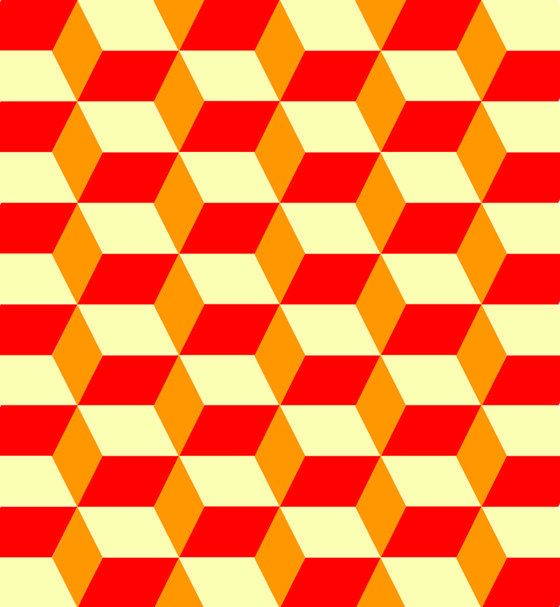

In [104]:
! wget "https://i.pinimg.com/1200x/d7/ab/78/d7ab78073fa05268a02f9b381064364b.jpg" -O regular_pattern.png
regular_image_path = "./regular_pattern.png"
Image.open(regular_image_path)

Test your method with the your implentation on this image to see it fails!

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

Step 50, Style Loss: 10.426595687866211
Step 100, Style Loss: 10.418072700500488
Step 150, Style Loss: 10.425992965698242
Step 200, Style Loss: 10.425623893737793
Step 250, Style Loss: 10.419132232666016
Step 300, Style Loss: 10.435972213745117
Step 350, Style Loss: 10.406190872192383
Step 400, Style Loss: 10.413198471069336
Step 450, Style Loss: 10.431015968322754
Step 500, Style Loss: 10.4097900390625
Step 550, Style Loss: 10.439602851867676
Step 600, Style Loss: 10.419526100158691
Step 650, Style Loss: 10.402444839477539
Step 700, Style Loss: 10.409083366394043
Step 750, Style Loss: 10.403016090393066
Step 800, Style Loss: 10.430709838867188
Step 850, Style Loss: 10.410524368286133
Step 900, Style Loss: 10.433732986450195
Step 950, Style Loss: 10.406999588012695
Step 1000, Style Loss: 10.416757583618164
Step 1050, Style Loss: 10.409385681152344
Step 1100, Style Loss: 10.399060249328613
Step 1150, Style Loss: 10.407362937927246
Step 1200, Style Loss: 10.401725769042969
Step 1250, Sty

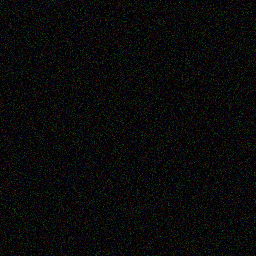

In [ ]:
style_img = load_image(regular_image_path, loader)
input_img = torch.randn(style_img.data.size(), device=device)
loss_method = "gram"

#begin_solution

input_img = torch.nn.functional.interpolate(input_img, scale_factor=0.5, mode='bilinear')
input_img = torch.nn.functional.interpolate(input_img, size=style_img.shape[-2:])

style_features_extractor = StyleFeaturesExtractor(
  cnn=cnn,
  style_img=style_img,
  normalization_mean=cnn_normalization_mean,
  normalization_std=cnn_normalization_std,
  num_layers=17
)

output_img = run_texture_synthesis(style_features_extractor, input_img, num_steps=2000, loss_method=loss_method)
unload_image(output_img)

#end_solution


Implement your solution to fix it. Also explain in a few words.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

Step 50, Style Loss: 0.8353268504142761
Step 100, Style Loss: 0.265145480632782
Step 150, Style Loss: 0.150992751121521
Step 200, Style Loss: 0.13824468851089478
Step 250, Style Loss: 0.17377406358718872
Step 300, Style Loss: 0.1492365598678589
Step 350, Style Loss: 0.13510870933532715
Step 400, Style Loss: 0.4225807189941406
Step 450, Style Loss: 0.43457210063934326
Step 500, Style Loss: 0.43294835090637207
Step 550, Style Loss: 0.43187570571899414
Step 600, Style Loss: 0.430722177028656
Step 650, Style Loss: 0.42901551723480225
Step 700, Style Loss: 0.4277873635292053
Step 750, Style Loss: 0.4264490604400635
Step 800, Style Loss: 0.4250596761703491
Step 850, Style Loss: 0.42368853092193604
Step 900, Style Loss: 0.4226072430610657
Step 950, Style Loss: 0.42068690061569214
Step 1000, Style Loss: 0.4190521240234375


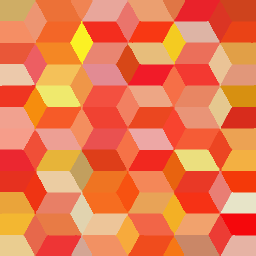

In [ ]:
style_img = load_image(regular_image_path, loader)
input_img = torch.randn(style_img.data.size(), device=device)

#begin_solution

loss_method = "gram"

def edge_detection(input_img):
  sobel_x = torch.tensor([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype=torch.float32, device=input_img.device).view(1, 1, 3, 3)
  sobel_y = torch.tensor([[-1, -2, -1], [0, 0, 0], [1, 2, 1]], dtype=torch.float32, device=input_img.device).view(1, 1, 3, 3)

  edges = []
  for channel in input_img.split(1, dim=1):
    edges_x = F.conv2d(channel, sobel_x, padding=1)
    edges_y = F.conv2d(channel, sobel_y, padding=1)
    edges.append(torch.sqrt(edges_x ** 2 + edges_y ** 2))

  return torch.cat(edges, dim=1)

style_img_edges = edge_detection(style_img)

input_img = torch.nn.functional.interpolate(input_img, scale_factor=0.5, mode='bilinear')
input_img = torch.nn.functional.interpolate(input_img, size=style_img.shape[-2:])
input_img *= 0.1

style_features_extractor = StyleFeaturesExtractor(
  cnn=cnn,
  style_img=style_img,
  normalization_mean=cnn_normalization_mean,
  normalization_std=cnn_normalization_std,
  num_layers=17
)

output_img = run_texture_synthesis(style_features_extractor, input_img, num_steps=1000, loss_method=loss_method)
unload_image(output_img)

def create_region_mask(edge_image):
  edge_mask = (edge_image.mean(dim=1) > 0.1).float()

  region_mask = 1 - edge_mask

  from skimage.measure import label

  region_mask_np = region_mask.squeeze().detach().cpu().numpy()
  labeled_regions = label(region_mask_np)

  region_mask_tensor = torch.tensor(labeled_regions, device=edge_image.device)

  return region_mask_tensor

region_mask = create_region_mask(style_img_edges)

def fill_regions_with_texture(texture_image, region_mask):
  unique_labels = torch.unique(region_mask)

  filled_image = torch.zeros_like(texture_image)

  _, _, height, width = texture_image.shape

  texture_colors = texture_image.permute(0, 2, 3, 1).detach().cpu().numpy().reshape(-1, 3)

  region_mask_flat = region_mask.detach().cpu().numpy().flatten()

  for label in unique_labels:
    if label.item() == 0:
        continue

    color_mask = (region_mask == label).float()

    color_mask_reshaped = color_mask.view(1, 1, height, width)

    region_indices = (region_mask_flat == label.item())

    region_color = texture_colors[region_indices]

    if len(region_color) > 0:
      mean_color = region_color.mean(axis=0)

      color_tensor = torch.tensor(mean_color, device=texture_image.device).view(1, 3, 1, 1)

      filled_image += color_mask_reshaped * color_tensor

  return filled_image

filled_image = fill_regions_with_texture(output_img, region_mask)

def change_black_pixels_to_neighbors(filled_image):
  filled_image_np = filled_image.squeeze(0).permute(1, 2, 0).detach().cpu().numpy()

  black_mask = (filled_image_np.mean(axis=-1) < 0.1)

  height, width = filled_image_np.shape[:2]

  modified_image = filled_image_np.copy()

  for y in range(height):
    for x in range(width):
      if black_mask[y, x]:
        neighbors = []
        for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
          ny, nx = y + dy, x + dx
          if 0 <= ny < height and 0 <= nx < width:
            if not black_mask[ny, nx]:
              neighbors.append(filled_image_np[ny, nx])

        if neighbors:
          avg_color = np.mean(neighbors, axis=0)
          modified_image[y, x] = avg_color

  modified_image_tensor = torch.tensor(modified_image).permute(2, 0, 1).unsqueeze(0).to(filled_image.device)

  return modified_image_tensor

for i in range(5):
  filled_image = change_black_pixels_to_neighbors(filled_image)

unload_image(filled_image)


#end_solution


Your answer:

The Gram matrix includes correlations without preserving spatial arrangements, which can lead to an inability to distinguish regular patterns. The loss becomes very big and the output is not acceptable.

To address the limitations, I enhance the texture synthesis process by incorporating additional techniques.

Edge detection (via Sobel filters) is used to identify edges, preserving boundary information. Then a corresponding region mask is created. After that, assign colours to regions based on output texture using the gram matrix. Finally, modify the remaining edge pixels (black) by averaging nearby pixels.

By integrating these strategies, the positional information is retained to improve the final output.

However, by using these, the generated texture has the exact same pattern shape as the style image.  Positional encoding and image patches can be used to add more variety.

**Question 4g**
<a name='question4g'></a>

How can you use the answer of this section to generate a good hidden test image for Question 2. Write no more than one sentence.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

Step 50, Style Loss: 0.8413681983947754
Step 100, Style Loss: 0.15440517663955688
Step 150, Style Loss: 0.08332210779190063
Step 200, Style Loss: 0.06374329328536987
Step 250, Style Loss: 0.056713759899139404
Step 300, Style Loss: 0.05235576629638672
Step 350, Style Loss: 0.04864001274108887
Step 400, Style Loss: 0.04566282033920288
Step 450, Style Loss: 0.043075501918792725
Step 500, Style Loss: 0.04073894023895264
Step 550, Style Loss: 0.038604736328125
Step 600, Style Loss: 0.036774635314941406
Step 650, Style Loss: 0.03527486324310303
Step 700, Style Loss: 0.03405946493148804
Step 750, Style Loss: 0.03308969736099243
Step 800, Style Loss: 0.032321274280548096
Step 850, Style Loss: 0.03171133995056152
Step 900, Style Loss: 0.031228721141815186
Step 950, Style Loss: 0.030842721462249756
Step 1000, Style Loss: 0.03053128719329834
Step 1050, Style Loss: 0.030272603034973145
Step 1100, Style Loss: 0.03006190061569214
Step 1150, Style Loss: 0.02988189458847046
Step 1200, Style Loss: 0.02

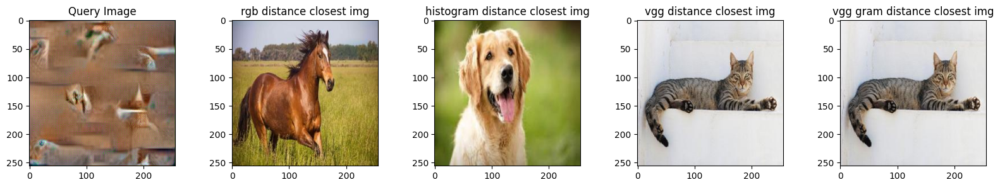

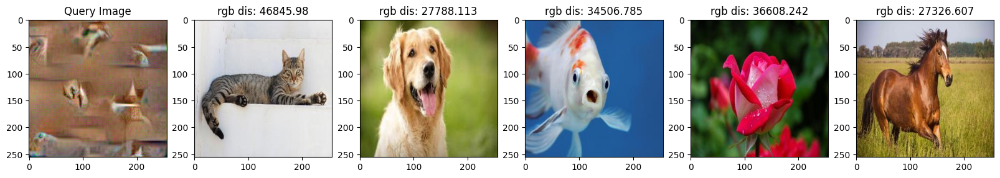

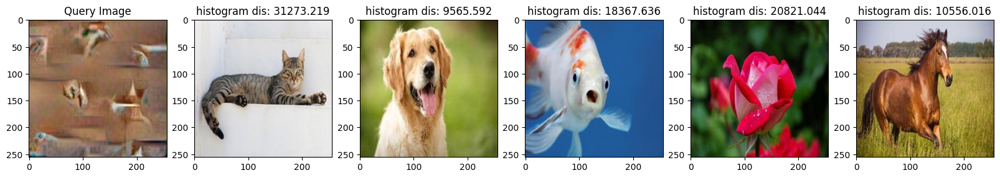

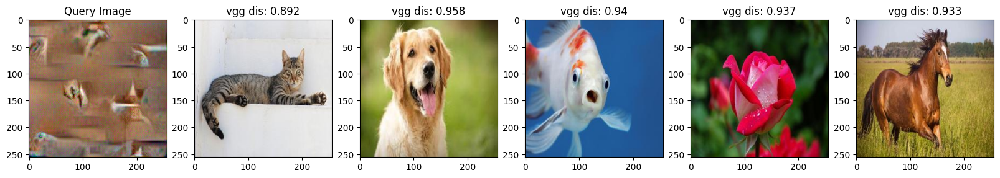

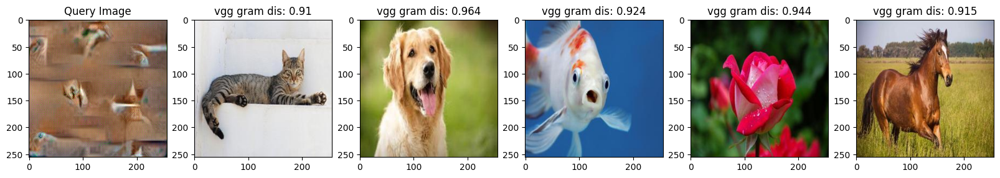

In [ ]:
#begin_solution

style_img = load_image('/content/dataset/Image_Retrieval_student_data/query.JPEG', loader)

input_img = torch.randn(style_img.data.size(), device=device)
loss_method = "gram"

input_img = torch.nn.functional.interpolate(input_img, scale_factor=0.5, mode='bilinear')
input_img = torch.nn.functional.interpolate(input_img, size=style_img.shape[-2:])

style_features_extractor = StyleFeaturesExtractor(
  cnn=cnn,
  style_img=style_img,
  normalization_mean=cnn_normalization_mean,
  normalization_std=cnn_normalization_std,
  num_layers=17
)

output_img = run_texture_synthesis(style_features_extractor, input_img, num_steps=2000, loss_method=loss_method)
new_query = unload_image(output_img)

test_retrieval(new_query, database_imgs_list)

#end_solution



Your answer

By applying texture synthesis using gram matrix loss on the original query image, a new query image is generated, and it can be used in question 2 to see if similar images can be retrieved.

## 5. Implicit Neural Representation (30 points)
The objective here is to learn an implicit neural function to predict frames of an animated 2D object. That is, learn a function $f(x,y,t; \theta)$, where $\theta$ are learnable MLP weights, that takes as input pixel coordinates $x,y$ and time $t$ and predicts the pixel value at that location and time. The learned function should then be able to generate frames of the video at any given instance $t$. The task is divided into multiple incremental blocks as below:

[a)](#question5a) Fit an MLP model to a _single_ image. **(5 points)**

[b)](#question5b) Add positional encoding of pixels to improve prediction. **(5 points)**

[c)](#question5c) Adapt the framework to train an MLP to fit a sequence of frames instead of a single frame. **(8 points)**

[d)](#question5d) Fit the MLP to the sequence of frames with and without positional encoding on time, and report the result for both **(2 points)**

[e)](#question5e) Implement batching, to prevent memory issues when evaluating large number of pixels with the MLP. Size of a batch should not exceed 16000 **(5 points)**

[f)](#question5f) Generate a video of 100 frames uniformly sampled between the first and last frame. Since you trained on only 11 frames, by generating 100 frames you're interpolating unseen video frames. If your method works correctly, it should produce a continuous motion. If you overfit on the training frames, then it would give a discontinuous or jagged motion **(5 points)**


**Let's Prepare the animation inputs**

In [105]:
!wget 'https://upload.wikimedia.org/wikipedia/commons/0/07/The_Horse_in_Motion-anim.gif'

X = np.zeros((11,230,340),dtype=np.uint8)
with imageio.get_reader('The_Horse_in_Motion-anim.gif') as r:
    for i in range(11):
        X[i] = r.get_data(i)
        X[i,0:20] = 255
        X[i,200:] = 255
        X[i,:,300:] = 255
        X[i,:,:10] = 255

X_resized = np.stack([cv2.resize(X[k], (128,128), cv2.INTER_AREA) for k in range(X.shape[0])], axis=0)
for i in range(X_resized.shape[0]):
  X_resized[i] = np.where(X_resized[i]>60,0,1)

--2024-11-04 13:51:57--  https://upload.wikimedia.org/wikipedia/commons/0/07/The_Horse_in_Motion-anim.gif
Resolving upload.wikimedia.org (upload.wikimedia.org)... 103.102.166.240, 2001:df2:e500:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|103.102.166.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 648978 (634K) [image/gif]
Saving to: ‘The_Horse_in_Motion-anim.gif.3’

The_Horse_in_Motion 100%[===================>] 633.77K  --.-KB/s    in 0.02s   

2024-11-04 13:51:57 (29.1 MB/s) - ‘The_Horse_in_Motion-anim.gif.3’ saved [648978/648978]



Let's visualize the frames:

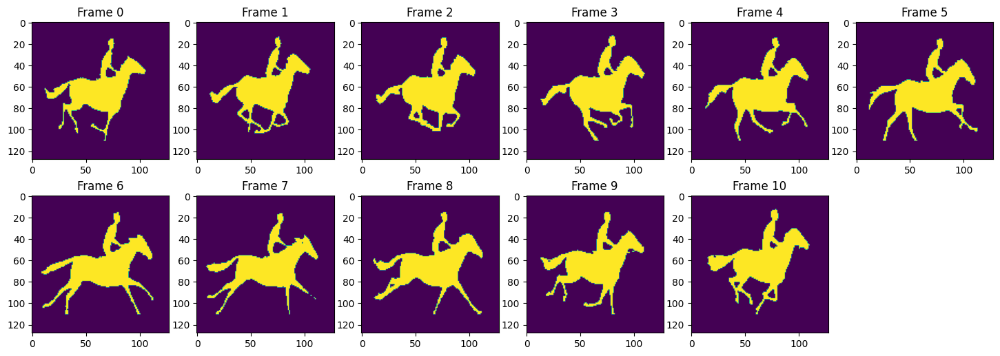

In [106]:
plt.figure(figsize=(6*3,2*3))
for i in range(11):
    plt.subplot(2,6,i+1)
    plt.imshow(X_resized[i])
    plt.title(f'Frame {i}')
plt.show()
plt.close()

Save the frames as a video sequence

In [107]:
output_path = 'input_bw_video.mp4'
with imageio.get_writer(output_path, mode='I', fps=10) as writer:
        for k in range(X_resized.shape[0]):
            writer.append_data(255*X_resized[k])
Video(output_path)

Visualization util method

In [108]:
def plot_implicit_representation_single_image(image, model, device='cuda'):

    '''
    Visualize implicit representation of image from training the MLP model

    Args:
        - image TORCHFLOAT32 (H,W)
        - model MLP model which takes as input batches (BATCH,K) and return pixel prediction of dim (BATCH,1)
    '''

    with torch.no_grad():
        U = predict_image(image, model, device='cuda')
    U = U.reshape((1,image.shape[0],image.shape[1]))
    U_bw = (U>0.5).type(torch.int32).cpu()

    plt.figure(figsize=(12,6))

    plt.subplot(1,3,1)
    plt.title('Implicit rep.')
    plt.imshow(U[0].cpu().numpy())
    plt.colorbar()
    plt.clim(0,1)

    plt.subplot(1,3,2)
    plt.imshow(U_bw[0].cpu().numpy())
    plt.title('Prediction')

    plt.subplot(1,3,3)
    plt.imshow(image.cpu())
    plt.title('Ground truth')

def plot_implicit_representation_multi_images(images, model, device='cuda'):

    '''
    Visualize implicit representation of a set of images from training the MLP model

    Args:
        - images TORCHFLOAT32 (N,H,W)
        - model MLP model which takes as input batches (BATCH,K) and return pixel prediction of dim (BATCH,1)
    '''

    with torch.no_grad():
        U = predict_images(images, model, device='cuda')
    U = U.reshape((images.shape[0],images.shape[1],images.shape[2])).cpu()
    U_bw = (U>0.5).type(torch.int32).cpu()

    for i in range(images.shape[0]):

        plt.figure(figsize=(12,6))

        plt.subplot(1,3,1)
        plt.title('Implicit rep.')
        plt.imshow(U[i].cpu().numpy())
        plt.colorbar()
        plt.clim(0,1)

        plt.subplot(1,3,2)
        plt.imshow(U_bw[i].cpu().numpy())
        plt.title('Prediction')

        plt.subplot(1,3,3)
        plt.imshow(images[i].cpu())
        plt.title(f'Ground truth Frame {i}')

def plot_loss_and_accuracy(loss_list,accuracy_list):
    plt.figure(figsize=(8*2,6))

    plt.subplot(1,2,1)
    plt.plot([x[0] for x in loss_list], [x[1] for x in loss_list])
    plt.title('Training loss')
    plt.xlabel('epochs')

    plt.subplot(1,2,2)
    plt.plot([x[0] for x in accuracy_list], [x[1] for x in accuracy_list])
    plt.title('Accuracy')
    plt.ylim(0.,1.)
    plt.xlabel('epochs')

**Question 5a**
<a name='question5a'></a>

Fit an MLP model to a single image

Below, write a MLP model which takes as input a pixel position (x,y) and return a pixel value prediction $p_{x,y}$

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [141]:
class MLP(nn.Module):
    '''
    MLP class
    '''
    def __init__(self,input_dimension, nb_layers, embedding_dimension, output_dimension):
        super(MLP, self).__init__()

        #begin_solution

        layers = []
        in_channels = input_dimension

        self.conv_preprocess = nn.Sequential(
          nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1),
          nn.ReLU(),
          nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
          nn.ReLU(),
          nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
          nn.ReLU(),
        )

        layers = [nn.Linear(in_channels + 64, embedding_dimension), nn.ReLU()]
        for _ in range(nb_layers - 1):
          layers.append(nn.Linear(embedding_dimension, embedding_dimension))
          layers.append(nn.BatchNorm1d(embedding_dimension))
          layers.append(nn.ReLU())

        layers.append(nn.Linear(embedding_dimension, output_dimension))
        self.model = nn.Sequential(*layers)

        self.register_buffer("image_features", torch.zeros(64))

        #end_solution


    def forward(self, input):
        #begin_solution
        image_features_expanded = self.image_features.expand(input.size(0), -1)
        input = input.to(device)

        input = torch.cat((input, image_features_expanded), dim=-1)
        prediction = self.model(input)
        #end_solution

        return prediction





Write a function which samples random pixel positions in an image

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [149]:
## Sample random pixel positions
def sample_image(image, n, scaled=True):
  '''
  Args:
    - image TORCHINT32 (H, W)
    - n : int, number of positions to sample
    - scaled: bool, if True, divide by the dimension
  Returns:
    - sampled_positions TORCHFLOAT32 ((n,2)), sampled positions
    - pixel_values TORCHINT32((n,)), sampled pixel values
  '''

  #begin_solution

  H, W = image.shape
  sampled_positions = torch.randint(0, H, (n, 2))
  pixel_values = image[sampled_positions.unbind(dim=1)]

  if scaled:
    sampled_positions = sampled_positions / torch.tensor([H, W])
  #end_solution


  return sampled_positions, pixel_values

Write a function that takes and image and a trained MLP and predicts all pixel values of the image. That is, for every $x,y$ in the given image, predict its pixel value with the MLP.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [150]:
def predict_image(image, model, device='cuda', scale=True):
  '''
  Reconstruct the complete set of images from the overfitted MLP model

  Args:
    - images TORCH_INT32 (H, W)
    - model, takes as input a batch of pixel positions and return pixel value
  Return:
    - prediction TORCHFLOAT32 (H, W) [CPU]
  '''
  #begin_solution

  H, W = image.shape

  positions = torch.stack(torch.meshgrid(torch.arange(H), torch.arange(W)), -1).reshape(-1,2).float()

  if scale:
    positions /= torch.tensor([H, W]).float()
  positions = positions.to(device)
  model = model.to(device)

  model.eval()
  with torch.no_grad():
    prediction = model(positions).reshape(H, W)

  prediction = prediction.cpu()

  #end_solution


  return prediction

Write a function to evaluate the model's prediction performance

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [151]:
## Compute accuracy over the set of frames
def eval_accuracy(image, model, device='cuda'):
  '''
  Args:
    - images TORCH_INT32 (H, W)
    - model, takes as input a batch of pixel positions and return pixel value
  Return:
    - mean_accuracy FLOAT32
  '''

  #begin_solution

  image = image.to(device)

  H, W = image.shape

  sampled_positions, pixel_values = sample_image(image, H * W)
  sampled_positions, pixel_values = sampled_positions.to(device), pixel_values.to(device)

  with torch.no_grad():
    predictions = model(sampled_positions).squeeze()

  accuracy = (predictions.round() == pixel_values.float()).float().mean().item()

  #end_solution


  return accuracy

Write the training loop. Train for a suitable number of epochs and while training populate the lists loss_list and accuracy_list with scalar values. These lists can be used for plotting later.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [152]:
loss_list, accuracy_list = [], []

#begin_solution
epochs = 500
learning_rate = 0.001
n_samples = 16000
device = 'cuda' if torch.cuda.is_available() else 'cpu'

model = MLP(input_dimension=2, nb_layers=8, embedding_dimension=128, output_dimension=1).to(device)
loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

image = torch.tensor(X_resized[5], dtype=torch.float32).to('cuda')
image = image.to(device)

for epoch in range(epochs):
  model.train()

  sampled_positions, pixel_values = sample_image(image, n_samples)
  sampled_positions, pixel_values = sampled_positions.to(device), pixel_values.to(device)

  predictions = model(sampled_positions)
  loss = loss_fn(predictions.squeeze(), pixel_values.float())

  optimizer.zero_grad()
  loss.backward()
  optimizer.step()

  loss_list.append((epoch, loss.item()))
  accuracy = eval_accuracy(image, model, device)
  accuracy_list.append((epoch, accuracy))

  if epoch % 10 == 0:
    print(f"Epoch {epoch}, Loss: {loss.item():.4f}, Accuracy: {accuracy:.4f}")

#end_solution


Epoch 0, Loss: 0.2616, Accuracy: 0.7543
Epoch 10, Loss: 0.0382, Accuracy: 0.9551
Epoch 20, Loss: 0.0282, Accuracy: 0.9701
Epoch 30, Loss: 0.0231, Accuracy: 0.9742
Epoch 40, Loss: 0.0198, Accuracy: 0.9739
Epoch 50, Loss: 0.0190, Accuracy: 0.9803
Epoch 60, Loss: 0.0234, Accuracy: 0.9733
Epoch 70, Loss: 0.0204, Accuracy: 0.9788
Epoch 80, Loss: 0.0149, Accuracy: 0.9823
Epoch 90, Loss: 0.0193, Accuracy: 0.9727
Epoch 100, Loss: 0.0138, Accuracy: 0.9792
Epoch 110, Loss: 0.0125, Accuracy: 0.9828
Epoch 120, Loss: 0.0155, Accuracy: 0.9808
Epoch 130, Loss: 0.0143, Accuracy: 0.9799
Epoch 140, Loss: 0.0133, Accuracy: 0.9843
Epoch 150, Loss: 0.0141, Accuracy: 0.9839
Epoch 160, Loss: 0.0125, Accuracy: 0.9810
Epoch 170, Loss: 0.0135, Accuracy: 0.9864
Epoch 180, Loss: 0.0165, Accuracy: 0.9857
Epoch 190, Loss: 0.0149, Accuracy: 0.9850
Epoch 200, Loss: 0.0170, Accuracy: 0.9861
Epoch 210, Loss: 0.0138, Accuracy: 0.9828
Epoch 220, Loss: 0.0185, Accuracy: 0.9849
Epoch 230, Loss: 0.0200, Accuracy: 0.9861
Epo

Save the model (needed for marking)

In [153]:
if not os.path.exists("models/"):
  os.makedirs("./models/")
torch.save({"model":model}, "models/implicit_single_image.pth")

Load the trained model

In [154]:
state_dict = torch.load("models/implicit_single_image.pth")
model = state_dict["model"].to(device)

<ipython-input-154-659405c1ce9d>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("models/implicit_single_image.pth")


Let's plot our performance

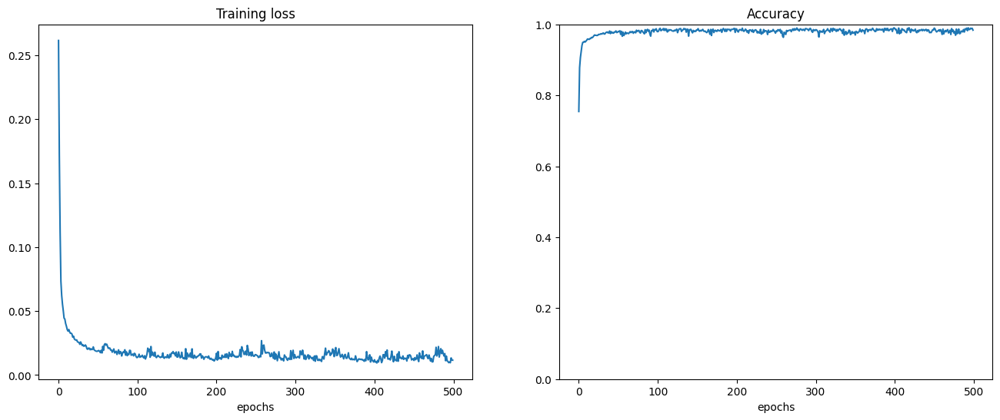

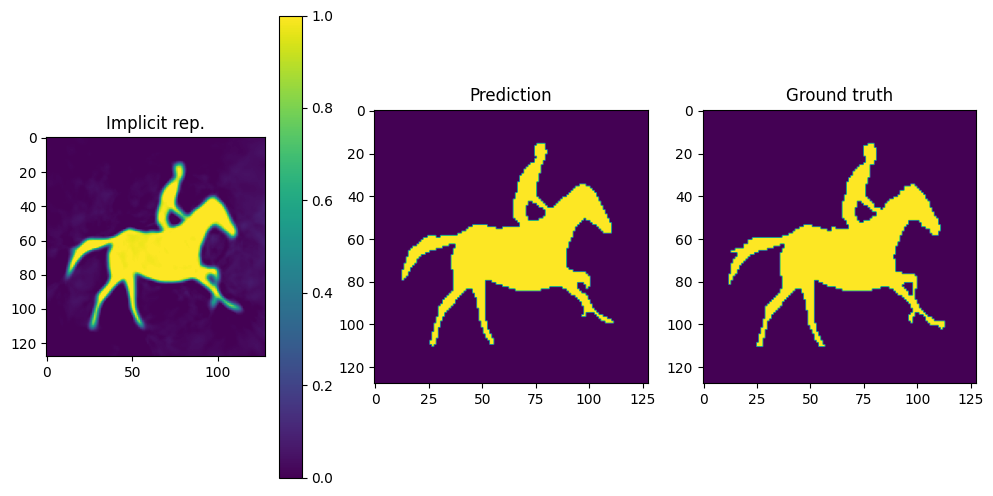

In [155]:
plot_loss_and_accuracy(loss_list,accuracy_list)
plot_implicit_representation_single_image(image, model, device='cuda')

**Question 5b**
<a name='question5b'></a>

Add positional encoding of pixels to improve predictions.

Write a function that positionally encodes the input.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [116]:
def positional_embedding_power_ls(X,L, cst=torch.pi):
    #begin_solution
    cos = []
    sin = []
    for i in range(L):
      cos.append(torch.cos((2**i) * cst * X))
      sin.append(torch.sin((2**i) * cst * X))
    freqs = torch.arange(0, L, dtype=torch.float32).unsqueeze(0)
    cos_encoding = torch.cat(cos, dim = -1)
    sin_encoding = torch.cat(sin, dim =  -1)
    #end_solution

    return torch.cat([cos_encoding, sin_encoding], axis=-1)

Write a new MLP, while reusing the previous MLP model, that can predict using the positionally encoded pixel locations.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [117]:
class MLP_PE(nn.Module):
    '''
    MLP with positional encoding class
    '''
    def __init__(self,input_dimension, nb_layers, embedding_dimension, output_dimension, positional_enc_L=0):
        super(MLP_PE, self).__init__()
        #begin_solution
        self.input_dimension = input_dimension
        self.positional_enc_L = positional_enc_L
        self.base_model = MLP(input_dimension * 2 * positional_enc_L, nb_layers, embedding_dimension, output_dimension)
        self.conv_preprocess = self.base_model.conv_preprocess

        self.register_buffer("features", torch.zeros(64))
        #end_solution


    def forward(self, input):

        #begin_solution

        if self.positional_enc_L > 0:
          input = positional_embedding_power_ls(input, self.positional_enc_L)

        features = self.features.expand(input.size(0), -1)

        input_with_encoding = torch.cat((input, features), dim = -1)

        prediction = self.base_model.model(input_with_encoding).to(device)

        #end_solution


        return prediction

Write the training loop similar to before. Train for a suitable number of epochs and while training populate the lists loss_list and accuracy_list with scalar values. These lists can be used for plotting later.

In [118]:
loss_list, accuracy_list = [], []

#begin_solution
epochs = 500
learning_rate = 0.001
n_samples = 16000
device = 'cuda' if torch.cuda.is_available() else 'cpu'

model = MLP_PE(input_dimension=2, nb_layers=8, embedding_dimension=128, output_dimension=1, positional_enc_L=10).to(device)
loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

image = torch.tensor(X_resized[10], dtype=torch.float32).to(device)

for epoch in range(epochs):
  model.train()

  sampled_positions, pixel_values = sample_image(image, n_samples)
  sampled_positions, pixel_values = sampled_positions.to(device), pixel_values.to(device)

  predictions = model(sampled_positions)
  loss = loss_fn(predictions.squeeze(), pixel_values.float())

  optimizer.zero_grad()
  loss.backward()
  optimizer.step()

  loss_list.append((epoch, loss.item()))
  accuracy = eval_accuracy(image, model, device)
  accuracy_list.append((epoch, accuracy))

  if epoch % 10 == 0:
    print(f"Epoch {epoch}, Loss: {loss.item():.4f}, Accuracy: {accuracy:.4f}")
#end_solution


Epoch 0, Loss: 0.2603, Accuracy: 0.8054
Epoch 10, Loss: 0.0484, Accuracy: 0.9561
Epoch 20, Loss: 0.0249, Accuracy: 0.9836
Epoch 30, Loss: 0.0137, Accuracy: 0.9946
Epoch 40, Loss: 0.0077, Accuracy: 0.9980
Epoch 50, Loss: 0.0045, Accuracy: 0.9998
Epoch 60, Loss: 0.0032, Accuracy: 0.9997
Epoch 70, Loss: 0.0020, Accuracy: 0.9996
Epoch 80, Loss: 0.0012, Accuracy: 0.9999
Epoch 90, Loss: 0.0008, Accuracy: 0.9998
Epoch 100, Loss: 0.0008, Accuracy: 1.0000
Epoch 110, Loss: 0.0008, Accuracy: 1.0000
Epoch 120, Loss: 0.0005, Accuracy: 1.0000
Epoch 130, Loss: 0.0004, Accuracy: 1.0000
Epoch 140, Loss: 0.0005, Accuracy: 1.0000
Epoch 150, Loss: 0.0004, Accuracy: 1.0000
Epoch 160, Loss: 0.0003, Accuracy: 1.0000
Epoch 170, Loss: 0.0002, Accuracy: 1.0000
Epoch 180, Loss: 0.0003, Accuracy: 1.0000
Epoch 190, Loss: 0.0002, Accuracy: 1.0000
Epoch 200, Loss: 0.0003, Accuracy: 1.0000
Epoch 210, Loss: 0.0004, Accuracy: 1.0000
Epoch 220, Loss: 0.0004, Accuracy: 1.0000
Epoch 230, Loss: 0.0006, Accuracy: 1.0000
Epo

Save the model (needed for marking)

In [119]:
if not os.path.exists("models/"):
  os.makedirs("./models/")
torch.save({"model":model}, "models/implicit_single_image_positional_encoding.pth")

Load the trained model

In [120]:
state_dict = torch.load("models/implicit_single_image_positional_encoding.pth")
model = state_dict["model"].to(device)

<ipython-input-120-5ae885305ec2>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("models/implicit_single_image_positional_encoding.pth")


Let's plot our performance.

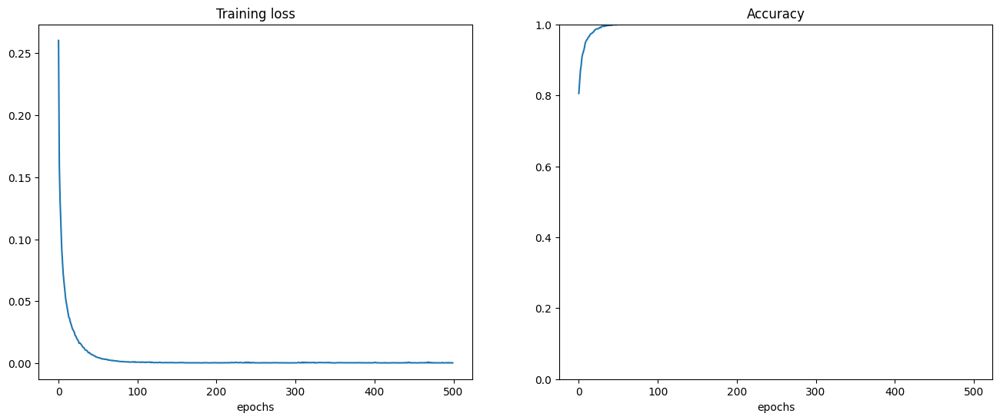

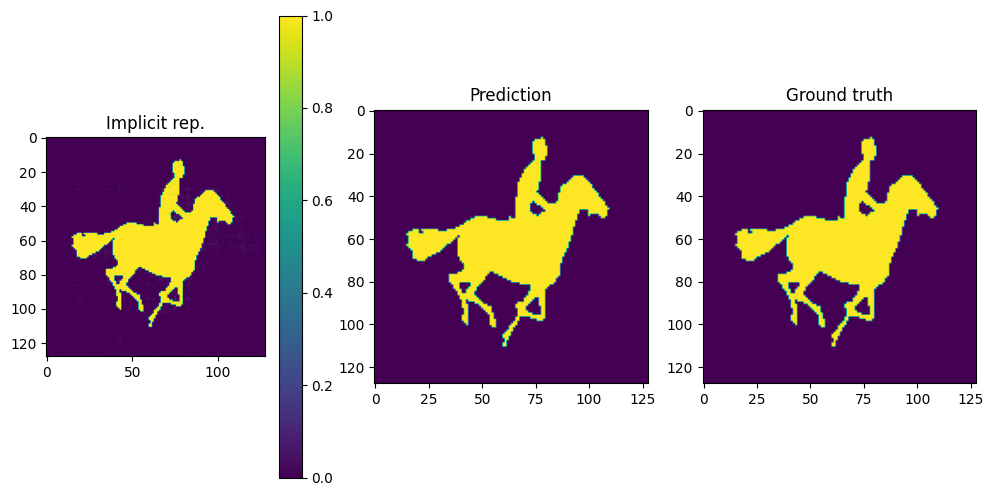

In [121]:
plot_loss_and_accuracy(loss_list,accuracy_list)
plot_implicit_representation_single_image(image, model, device='cuda')

**Question 5c**
<a name='question5c'></a>

Adapt the framework to train an MLP to fit a sequence of frames instead of a single frame. You'd need to rewrite image sampling and other functions to achieve this.

Write a function that can now also sample across the time dimension.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [122]:
def sample_images(images, n, scaled=True):
  '''
  Args:
    - images TORCHINT32 (N_frames, H, W)
    - n : int, number of positions to sample
    - scaled: bool, if True, divide by the dimension
  Returns:
    - sampled_positions TORCHFLOAT32 ((n,3)), sampled positions
    - pixel_values TORCHINT32((n,)), sampled pixel values
  '''

  #begin_solution

  N_frames, H, W = images.shape

  frame_indices = torch.randint(0, N_frames, (n,))
  x_indices = torch.randint(0, H, (n,))
  y_indices = torch.randint(0, W, (n,))

  sampled_positions = torch.stack((frame_indices.float(), x_indices.float(), y_indices.float(),), dim=-1)

  pixel_values = images[frame_indices, x_indices, y_indices]

  if scaled:
    sampled_positions /= torch.tensor([N_frames, H, W]).float()

  #end_solution

  return sampled_positions, pixel_values


Write a function to predict the images, now also across time.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [123]:
def predict_images(images, model, device='cuda', scale=True):
  '''
  Reconstruct the complete set of images from the overfitted MLP model

  Args:
    - images TORCH_INT32 (N_frames, H, W)
    - model, takes as input a batch of pixel positions (K,2) and return pixel value (K,1)
  Return:
    - prediction TORCHFLOAT32 (N_frames, H, W) [CPU]
  '''
  #begin_solution

  N_frames, H, W = images.shape

  positions = torch.stack(torch.meshgrid(torch.arange(N_frames), torch.arange(H), torch.arange(W)), -1).reshape(-1,3).float()

  if scale:
    positions /= torch.tensor([N_frames, H, W]).float()

  positions = positions.to(device)
  model = model.to(device)

  with torch.no_grad():
    prediction = model(positions).reshape(N_frames, H, W)

  prediction = prediction.cpu()

  #end_solution


  return prediction

Write a function to evaluate performance across time.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [124]:
## Compute accuracy over the set of frames
def eval_mean_accuracy(images, model, device='cuda'):
  '''
  Args:
    - images TORCH_INT32 (N_frames, H, W)
    - model, takes as input a batch of pixel positions (K,2) and return pixel value (K,1)
  Return:
    - mean_accuracy FLOAT32
  '''
  #begin_solution

  images = images.to(device)

  N_frames, H, W = images.shape

  sampled_positions, pixel_values = sample_images(images, N_frames * H * W)
  sampled_positions, pixel_values = sampled_positions.to(device), pixel_values.to(device)

  with torch.no_grad():
    predictions = model(sampled_positions).squeeze()

  accuracy = (predictions.round() == pixel_values.float()).float().mean().item()

  #end_solution


  return accuracy

Write the training loop similar to before. Train for a suitable number of epochs and while training populate the lists loss_list and accuracy_list with scalar values. These lists can be used for plotting later.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [126]:
loss_list, accuracy_list = [], []

#begin_solution

epochs = 500
learning_rate = 0.001
n_samples = 16000
device = 'cuda' if torch.cuda.is_available() else 'cpu'

model = MLP_PE(input_dimension=3, nb_layers=10, embedding_dimension=128, output_dimension=1, positional_enc_L=10).to(device)
loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

images = torch.tensor(X_resized, dtype=torch.float32).to(device)

for epoch in range(epochs):
  model.train()

  sampled_positions, pixel_values = sample_images(images, n_samples)
  sampled_positions, pixel_values = sampled_positions.to(device), pixel_values.to(device)

  predictions = model(sampled_positions)
  loss = loss_fn(predictions.squeeze(), pixel_values.float())

  optimizer.zero_grad()
  loss.backward()
  optimizer.step()

  loss_list.append((epoch, loss.item()))
  accuracy = eval_mean_accuracy(images, model, device)
  accuracy_list.append((epoch, accuracy))

  if epoch % 10 == 0:
    print(f"Epoch {epoch}, Loss: {loss.item():.4f}, Accuracy: {accuracy:.4f}")

#end_solution


Epoch 0, Loss: 0.2197, Accuracy: 0.8015
Epoch 10, Loss: 0.0844, Accuracy: 0.9020
Epoch 20, Loss: 0.0570, Accuracy: 0.9312
Epoch 30, Loss: 0.0447, Accuracy: 0.9453
Epoch 40, Loss: 0.0372, Accuracy: 0.9541
Epoch 50, Loss: 0.0303, Accuracy: 0.9616
Epoch 60, Loss: 0.0282, Accuracy: 0.9670
Epoch 70, Loss: 0.0236, Accuracy: 0.9712
Epoch 80, Loss: 0.0194, Accuracy: 0.9751
Epoch 90, Loss: 0.0186, Accuracy: 0.9772
Epoch 100, Loss: 0.0167, Accuracy: 0.9804
Epoch 110, Loss: 0.0142, Accuracy: 0.9823
Epoch 120, Loss: 0.0128, Accuracy: 0.9852
Epoch 130, Loss: 0.0113, Accuracy: 0.9866
Epoch 140, Loss: 0.0104, Accuracy: 0.9883
Epoch 150, Loss: 0.0104, Accuracy: 0.9905
Epoch 160, Loss: 0.0089, Accuracy: 0.9910
Epoch 170, Loss: 0.0078, Accuracy: 0.9915
Epoch 180, Loss: 0.0071, Accuracy: 0.9926
Epoch 190, Loss: 0.0065, Accuracy: 0.9925
Epoch 200, Loss: 0.0057, Accuracy: 0.9934
Epoch 210, Loss: 0.0064, Accuracy: 0.9933
Epoch 220, Loss: 0.0056, Accuracy: 0.9943
Epoch 230, Loss: 0.0052, Accuracy: 0.9948
Epo

Save the model (needed for marking)

In [127]:
if not os.path.exists("models/"):
  os.makedirs("./models/")
torch.save({"model":model}, "models/implicit_images_sequence.pth")

Load the trained model

In [128]:
state_dict = torch.load("models/implicit_images_sequence.pth")
model = state_dict["model"].to(device)

<ipython-input-128-30951ad2708d>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("models/implicit_images_sequence.pth")


Let's plot our performance

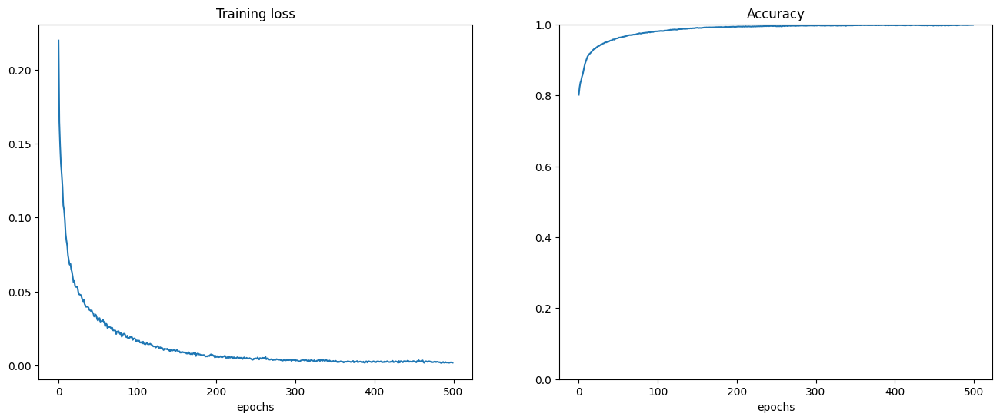

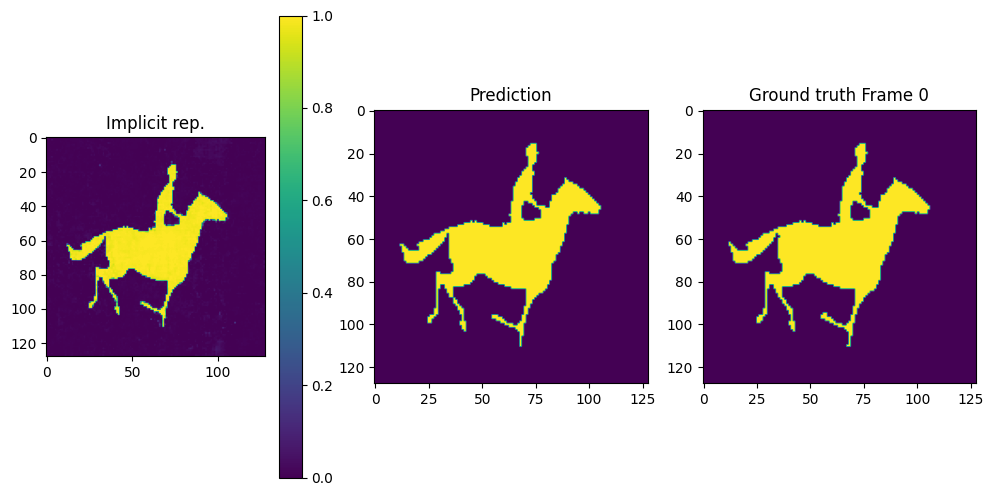

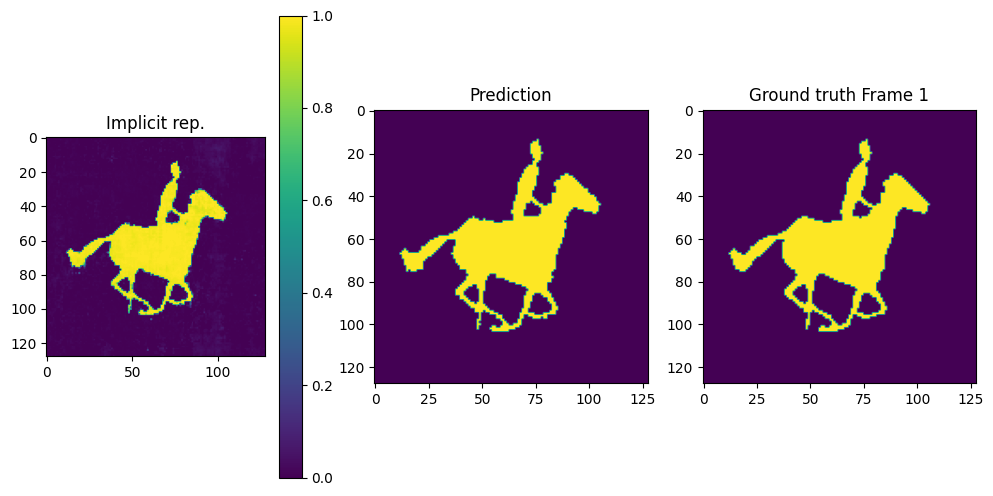

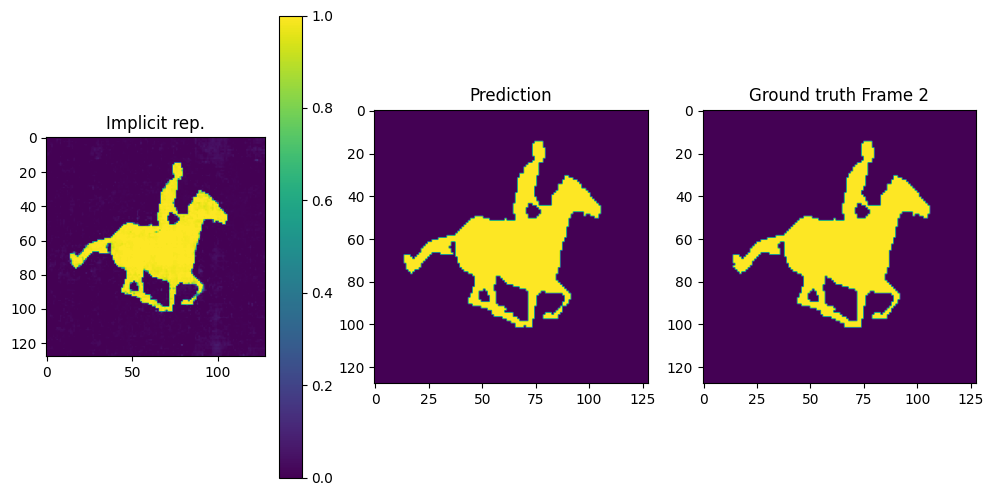

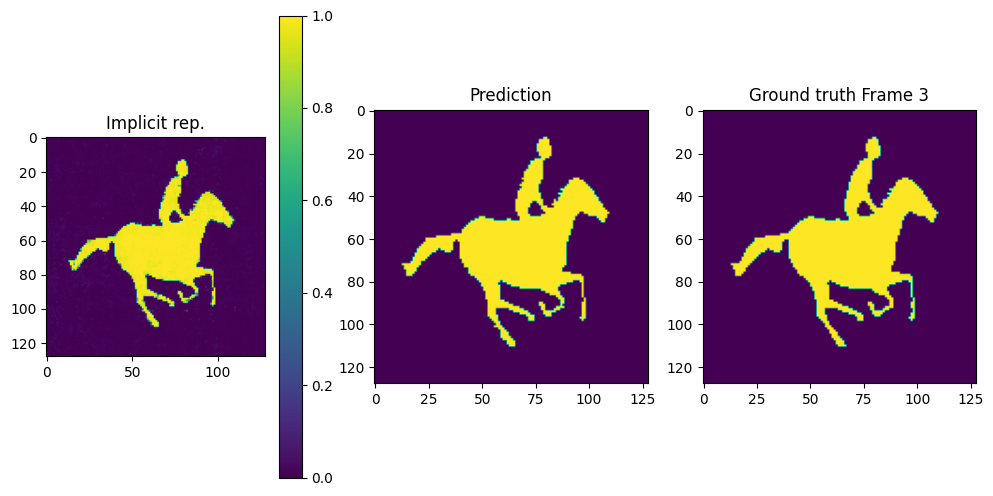

...

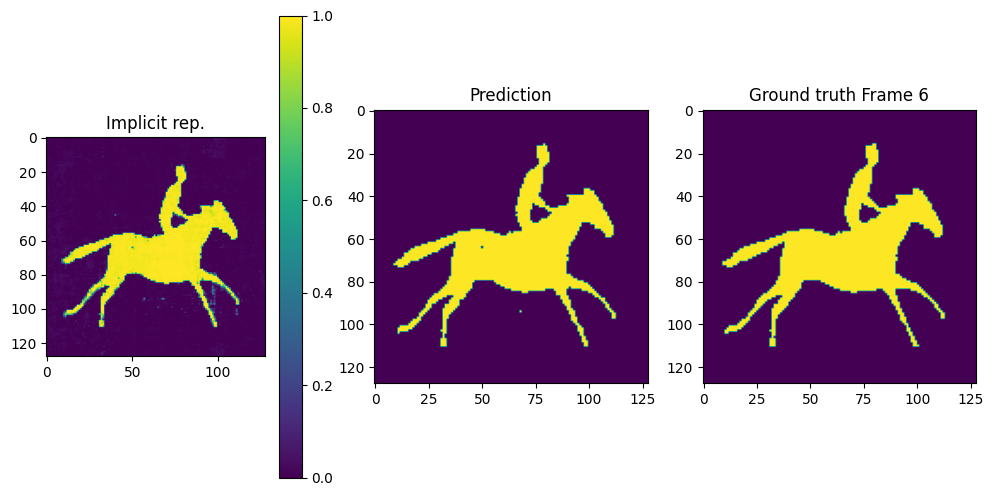

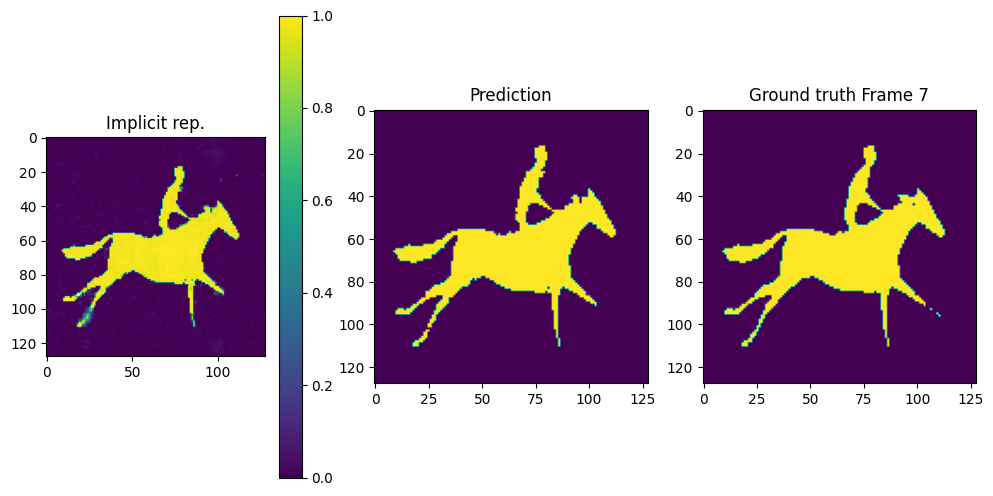

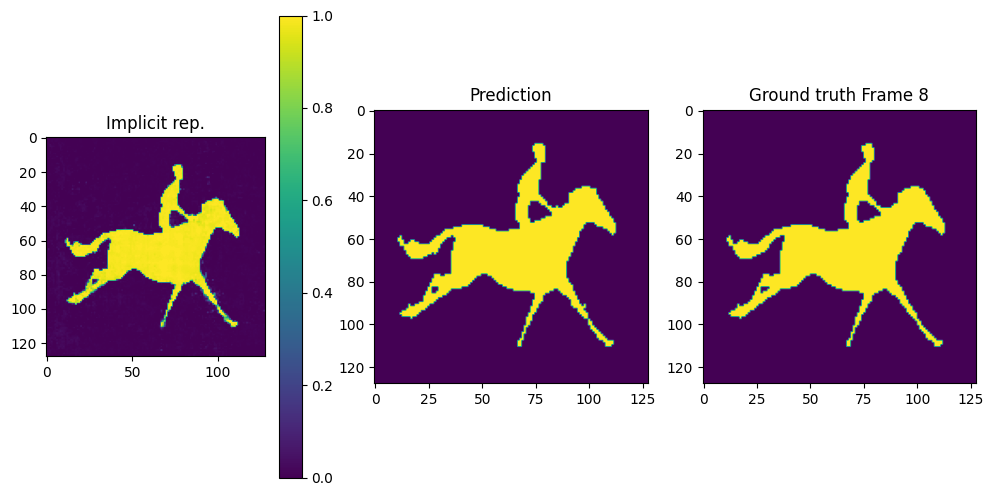

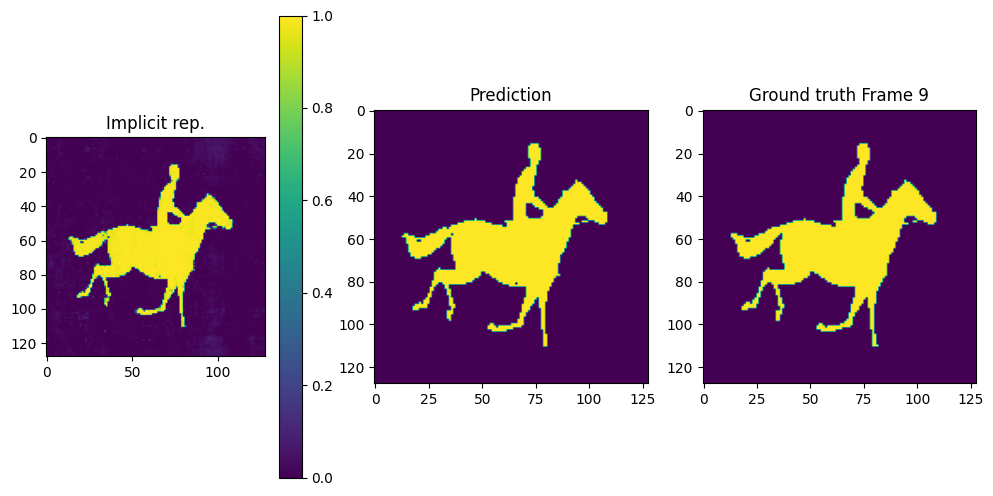

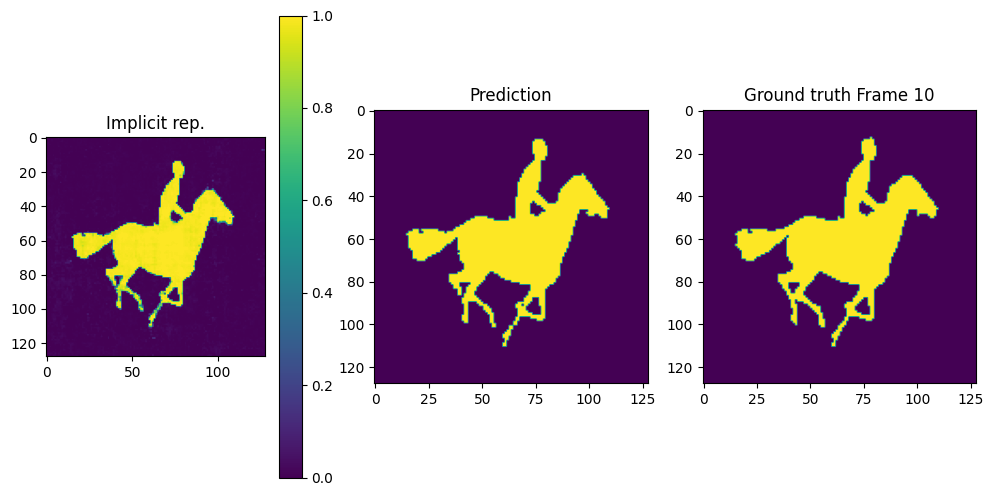

In [129]:
plot_loss_and_accuracy(loss_list,accuracy_list)
plot_implicit_representation_multi_images(images, model, device='cuda')

**Question 5d**
<a name='question5d'></a>

Apply positional encoding for the time dimension.

Write a function that positionally encodes time values, with an optional flag to enable or disable it.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [130]:
def positional_embedding_power_ls(X,L, cst=torch.pi, encode_time_dimension=True):
    #begin_solution

    cos_encoding_list = []
    sin_encoding_list = []

    for i in range(L):
      if encode_time_dimension:

        cos_encoding = torch.cos((2**i) * cst * X[:, 0:1])
        sin_encoding = torch.sin((2**i) * cst * X[:, 0:1])

        cos_encoding_list.append(cos_encoding)
        sin_encoding_list.append(sin_encoding)

      cos_encoding = torch.cos((2**i) * cst * X[:, 1:])
      sin_encoding = torch.sin((2**i) * cst * X[:, 1:])

      cos_encoding_list.append(cos_encoding)
      sin_encoding_list.append(sin_encoding)

    encoding = torch.cat(cos_encoding_list + sin_encoding_list, dim=-1)

    #end_solution

    return encoding

Write a new MLP, while re-using the previous one, that now predicts using the positionally encoded time. It should also predict without positional encoding, for comparison.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [131]:
class MLP_PE_time_option(nn.Module):
    '''
    MLP class
    '''
    def __init__(self,input_dimension, nb_layers, embedding_dimension, output_dimension,
                 positional_enc_L=0,encode_time_dimension=True):
        super(MLP_PE_time_option, self).__init__()
        #begin_solution
        self.input_dimension = input_dimension
        self.positional_enc_L = positional_enc_L
        self.encode_time_dimension = encode_time_dimension

        if positional_enc_L > 0:
          if encode_time_dimension:
            encoded_input_dimension = input_dimension * positional_enc_L * 2
          else:
            encoded_input_dimension = (input_dimension - 1) * positional_enc_L * 2
        else:
          encoded_input_dimension = input_dimension

        self.base_model = MLP(encoded_input_dimension, nb_layers, embedding_dimension, output_dimension)
        self.conv_preprocess = self.base_model.conv_preprocess
        self.register_buffer("features", torch.zeros(64))
        #end_solution


    def forward(self, input):
        #begin_solution

        if self.positional_enc_L > 0:
          input = positional_embedding_power_ls(input, self.positional_enc_L, encode_time_dimension=self.encode_time_dimension)

        features = self.features.expand(input.size(0), -1)

        input_with_encoding = torch.cat((input, features), dim = -1)

        prediction = self.base_model.model(input_with_encoding).to(device)

        #end_solution

        return prediction


Write the training loop similar to before. Train for a suitable number of epochs and while training populate the lists loss_list and accuracy_list. These lists can be used for plotting later.

Note that this time, the two lists are nested. Each list should contain two sub-lists, one with Positional Encoding turned ON and other with Positional Encoding turned oFF. Each sub-list, similar to before, has scalar loss/acurracy values in each epoch.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [132]:
loss_list, accuracy_list = [[],[]], [[],[]]

# Assign your model to these variables depending on whether they have time encoding or not.
# We'll save these models to disk later
mlp_model_with_time_encoding = None
mlp_model_without_time_encoding = None

#begin_solution

def train_mlp(model, i):

  epochs = 500
  learning_rate = 0.001
  n_samples = 16000
  device = 'cuda' if torch.cuda.is_available() else 'cpu'

  loss_fn = nn.MSELoss()
  optimizer = optim.Adam(model.parameters(), lr=learning_rate)

  images = torch.tensor(X_resized, dtype=torch.float32).to(device)
  model = model.to(device)

  for epoch in range(epochs):
    model.train()

    sampled_positions, pixel_values = sample_images(images, n_samples)
    sampled_positions, pixel_values = sampled_positions.to(device), pixel_values.to(device)

    optimizer.zero_grad()
    predictions = model(sampled_positions)
    loss = loss_fn(predictions.squeeze(), pixel_values.float())
    accuracy = eval_mean_accuracy(images, model, device=device)

    loss.backward()
    optimizer.step()

    if epoch % 10 == 0:
      print(f"Epoch {epoch}, Loss: {loss.item():.4f}, Accuracy: {accuracy:.4f}")

    loss_list[i].append((epoch, loss.item()))
    accuracy_list[i].append((epoch, accuracy))

mlp_model_with_time_encoding = MLP_PE_time_option(input_dimension=3, nb_layers=10, embedding_dimension=128, output_dimension=1, positional_enc_L=10, encode_time_dimension=True).to(device)
mlp_model_without_time_encoding = MLP_PE_time_option(input_dimension=3, nb_layers=10, embedding_dimension=128, output_dimension=1, positional_enc_L=10, encode_time_dimension=False).to(device)

train_mlp(mlp_model_with_time_encoding, 0)
train_mlp(mlp_model_without_time_encoding, 1)

#end_solution


Epoch 0, Loss: 0.6890, Accuracy: 0.4627
Epoch 10, Loss: 0.1008, Accuracy: 0.8772
Epoch 20, Loss: 0.0620, Accuracy: 0.9182
Epoch 30, Loss: 0.0519, Accuracy: 0.9349
Epoch 40, Loss: 0.0454, Accuracy: 0.9442
Epoch 50, Loss: 0.0366, Accuracy: 0.9530
Epoch 60, Loss: 0.0329, Accuracy: 0.9574
Epoch 70, Loss: 0.0287, Accuracy: 0.9633
Epoch 80, Loss: 0.0274, Accuracy: 0.9673
Epoch 90, Loss: 0.0235, Accuracy: 0.9721
Epoch 100, Loss: 0.0207, Accuracy: 0.9741
Epoch 110, Loss: 0.0188, Accuracy: 0.9763
Epoch 120, Loss: 0.0175, Accuracy: 0.9796
Epoch 130, Loss: 0.0153, Accuracy: 0.9816
Epoch 140, Loss: 0.0143, Accuracy: 0.9839
Epoch 150, Loss: 0.0135, Accuracy: 0.9840
Epoch 160, Loss: 0.0115, Accuracy: 0.9865
Epoch 170, Loss: 0.0109, Accuracy: 0.9870
Epoch 180, Loss: 0.0102, Accuracy: 0.9891
Epoch 190, Loss: 0.0110, Accuracy: 0.9866
Epoch 200, Loss: 0.0098, Accuracy: 0.9895
Epoch 210, Loss: 0.0075, Accuracy: 0.9908
Epoch 220, Loss: 0.0067, Accuracy: 0.9921
Epoch 230, Loss: 0.0064, Accuracy: 0.9929
Epo

Save the model (needed for marking)

In [133]:
if not os.path.exists("models/"):
  os.makedirs("./models/")
torch.save({"model":mlp_model_with_time_encoding}, "models/implicit_images_sequence_with_time_encoding.pth")
torch.save({"model":mlp_model_without_time_encoding}, "models/implicit_images_sequence_without_time_encoding.pth")

Let's plot both accuracies and loss curves.

Accuracy with time encoding : 0.998 without: 0.950


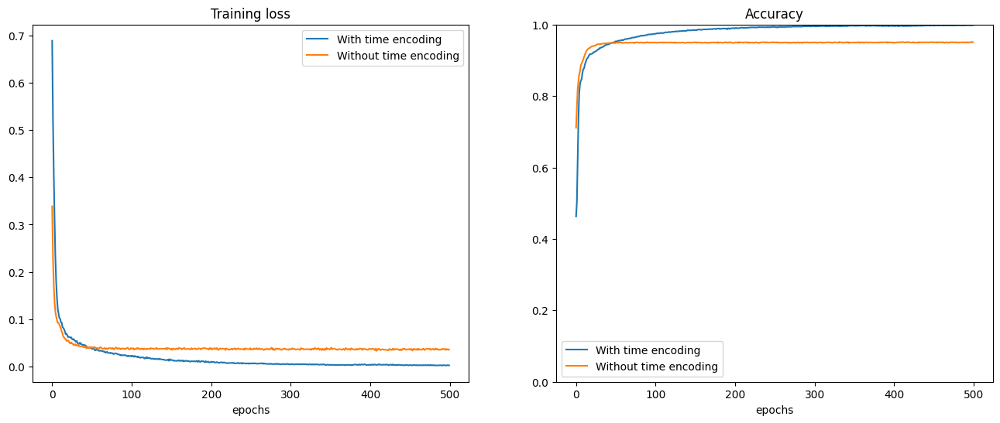

In [134]:
plt.figure(figsize=(8*2,6))

plt.subplot(1,2,1)
plt.plot([x[0] for x in loss_list[0]], [x[1] for x in loss_list[0]], label='With time encoding')
plt.plot([x[0] for x in loss_list[1]], [x[1] for x in loss_list[1]], label='Without time encoding')
plt.title('Training loss')
plt.legend()
plt.xlabel('epochs')

plt.subplot(1,2,2)
plt.plot([x[0] for x in accuracy_list[0]], [x[1] for x in accuracy_list[0]], label='With time encoding')
plt.plot([x[0] for x in accuracy_list[1]], [x[1] for x in accuracy_list[1]], label='Without time encoding')
plt.title('Accuracy')
plt.ylim(0.,1.)
plt.xlabel('epochs')
plt.legend()

print('Accuracy with time encoding : {:.3f} without: {:.3f}'.format(accuracy_list[0][-1][1],accuracy_list[1][-1][1]))

**Question 5e**
<a name='question5e'></a>

Implement batching to prevent memory issues when evaluating large number of pixels with the MLP. Batch size should not exceed 16000.

Write a partition indexing function to create a list of partition indices that can be used to split the input into equal size chunks for prediction

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [135]:
def partition_index(totalsize, chunksize):
    '''
    Args:
        - totalsize: int, Size of the batch to process
        - chunksize: int, subdivision to apply
    Return:
        - list_tuples: List, List of tuples (i,j) to process the batch in equal chunk
    '''
    #begin_solution

    list_tuples = []

    for start in range(0, totalsize, chunksize):
      end = min(start + chunksize, totalsize)
      list_tuples.append((start, end))

    #end_solution

    return list_tuples

Update image prediction to use the implemented batch partitioning

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [137]:
def predict_images(images, model, device='cuda', scale=True):
  '''
  Reconstruct the complete set of images from the overfitted MLP model

  Args:
    - images TORCH_INT32 (N_frames, H, W)
    - model, takes as input a batch of pixel positions (K,2) and return pixel value (K,1)
  Return:
    - prediction TORCHFLOAT32 (N_frames, H, W) [CPU]
  '''
  #begin_solution

  N_frames, H, W = images.shape

  positions = torch.stack(torch.meshgrid(torch.arange(N_frames), torch.arange(H), torch.arange(W)), -1).reshape(-1, 3).float()

  if scale:
    positions /= torch.tensor([N_frames, H, W]).float()

  positions = positions.to(device)
  model = model.to(device)

  shuffled_indices = torch.randperm(positions.size(0))
  shuffled_positions = positions[shuffled_indices]

  prediction = torch.zeros(N_frames, H, W, device=device)

  for start, end in partition_index(shuffled_positions.size(0), 16000):
    batch_positions = shuffled_positions[start:end]

    batch_predictions = model(batch_positions).cpu().squeeze().to(device)

    prediction.view(-1)[shuffled_indices[start:end]] = batch_predictions

  prediction = prediction.cpu()

  #end_solution




  return prediction


**Question 5f**
<a name='question5f'></a>

Write code to generate a video of 100 frames uniformly sampled between the first and last frame. Save the video as an MP4.

&#9998; <font color="#0047AB">
You need to modify the following cell with your own code.
</font>

In [161]:
output_path = 'result_bw_video.mp4'
#begin_solution

def generate_future_frames(images, model, num_future_frames, device='cuda', scale=True):

  N_frames, H, W = images.shape
  predictions = images.clone().to(device)

  with torch.no_grad():
    for t in range(num_future_frames):
      current_time_step = N_frames + t
      positions = torch.stack(torch.meshgrid(torch.arange(current_time_step + 1), torch.arange(H), torch.arange(W)), -1).reshape(-1, 3).float()

      if scale:
        positions /= torch.tensor([current_time_step + 1, H, W]).float()

      positions = positions.to(device)
      model = model.to(device)

      frame_prediction = torch.zeros(H, W, device=device)
      collected_predictions = []

      for start, end in partition_index(positions.size(0), 16000):
        batch_positions = positions[start:end]
        batch_predictions = model(batch_positions).cpu().squeeze().to(device)
        collected_predictions.append(batch_predictions)

      collected_predictions = torch.cat(collected_predictions, dim=0)

      latest_frame_predictions = collected_predictions[:H * W].view(H, W)

      latest_frame_bw = (latest_frame_predictions > 0.5).type(torch.int32)

      predictions = torch.cat([predictions, latest_frame_bw.unsqueeze(0)], dim=0)

  return predictions.cpu()

num_future_frames = 89
window_size = 11
images2 = images
frames = []

for t in range(num_future_frames):
  context_frames = images2[-window_size:].clone()
  context_time_step = images2.size(0) + t

  future_frame_predictions = generate_future_frames(context_frames, mlp_model_with_time_encoding, 1, device='cuda', scale=True)
  future_frame = future_frame_predictions[0]

  future_frame_bw = (future_frame > 0.5).type(torch.int32)

  future_frame_np = future_frame_bw.cpu().numpy()
  future_frame_np = (future_frame_np * 255 / future_frame_np.max()).astype(np.uint8)

  frames.append(future_frame_np)

  future_img = Image.fromarray(future_frame_np)

  future_frame_bw = future_frame_bw.to(images2.device)
  images2 = torch.cat([images2, future_frame_bw.unsqueeze(0)], dim=0)

with imageio.get_writer(output_path, mode='I', fps=10) as writer:
  for frame in frames:
    if len(frame.shape) == 2:
      frame_rgb = np.stack([frame] * 3, axis=-1)
    else:
      frame_rgb = frame

    writer.append_data(frame_rgb)

#end_solution

Video(output_path)